# MuTrans script: organoid cisplatin

## NB039 entry

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
import matplotlib.pyplot as plt
import pyMuTrans as pm
import hdf5plugin
import gc
import seaborn as sns

datadir = "data/"

In [2]:
adata = sc.read(datadir+'nb039_entry_seurat.h5ad')
adata

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 10740 × 22192
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Barcode', 'CellID', 'sizeFactor', 'description', 'CMO', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'sum', 'detected', 'subsets_mt_sum', 'subsets_mt_detected', 'subsets_mt_percent', 'subsets_linc_sum', 'subsets_linc_detected', 'subsets_linc_percent', 'subsets_ribo_sum', 'subsets_ribo_detected', 'subsets_ribo_percent', 'total', 'Seurat.Phase', 'Seurat.S', 'Seurat.G2M', 'Seurat.Cycle.Score', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.3', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'

In [3]:
adata.layers["raw_counts"] = adata.raw.X
adata.layers["seurat_lognorm"] = adata.X
adata.X = adata.raw.X

In [4]:
adata.obs = adata.obs[['Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig']]
adata.obsm = []
adata

AnnData object with n_obs × n_vars = 10740 × 22192
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'
    layers: 'raw_counts', 'seurat_lognorm'

In [5]:
# Check adata has raw counts matrix
df = pd.DataFrame.sparse.from_spmatrix(adata.X)
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,22182,22183,22184,22185,22186,22187,22188,22189,22190,22191
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,3.0,6.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,8.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


### Pre-processing

QC

In [6]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars = ['mt'], percent_top = None, log1p = False, inplace = True)

Normalisation

In [7]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)

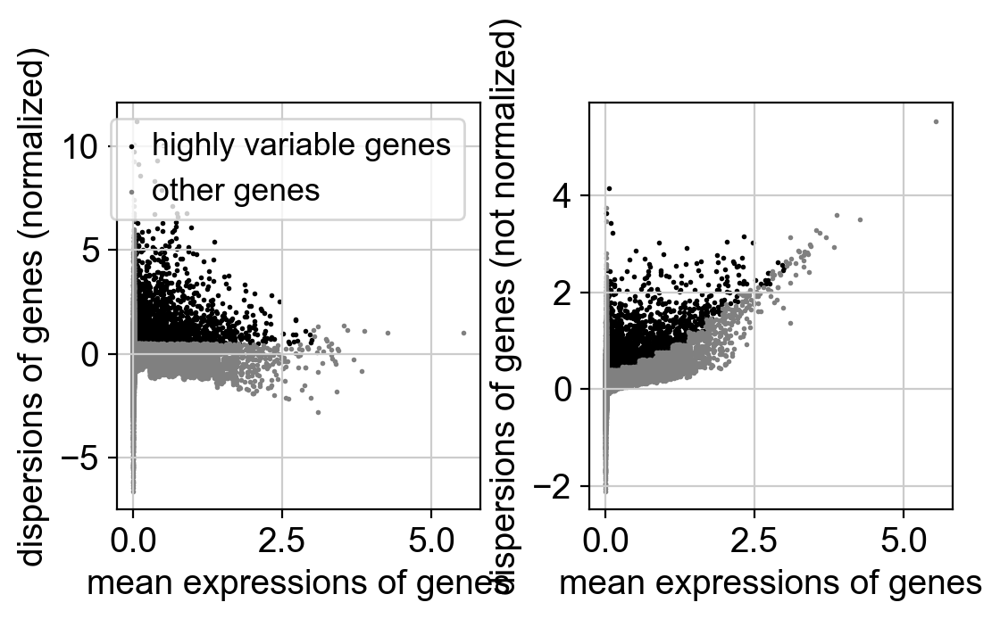

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
# Set .raw attribute of AnnData object to the normalised and logarithmized raw gene expression
adata.raw = adata
# Filter for highly variable genes
adata = adata[:, adata.var.highly_variable]

In [10]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df

In [11]:
sc.pp.scale(adata, max_value = 10) # Clips values exceeding sd = 10

Reduced dims

In [12]:
sc.tl.pca(adata, svd_solver = 'arpack')

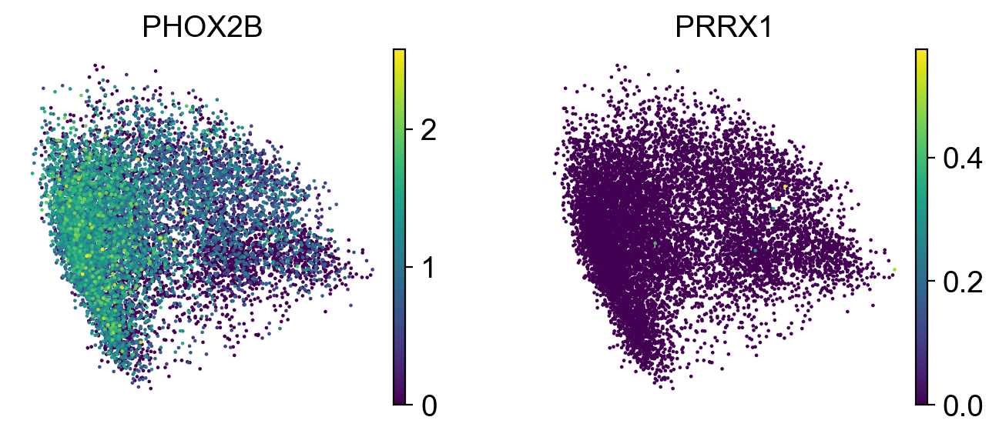

In [13]:
sc.pl.pca(adata, color = ['PHOX2B','PRRX1'])

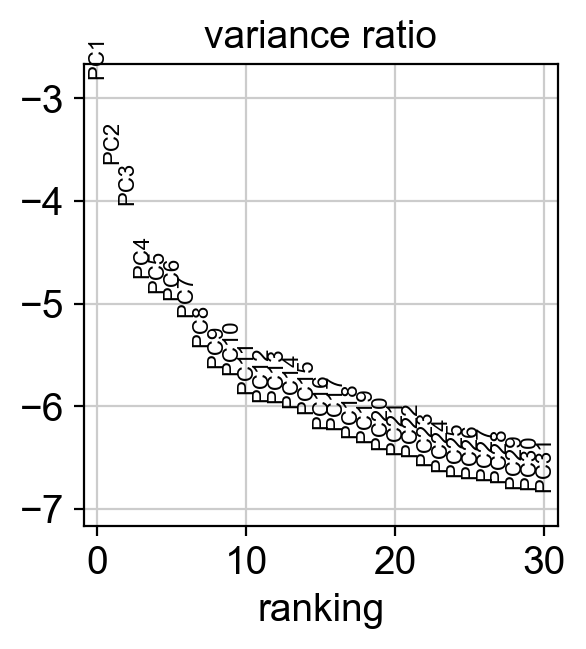

In [14]:
sc.pl.pca_variance_ratio(adata, log = True)

In [15]:
sc.pp.neighbors(adata, n_neighbors = 10, n_pcs = 40)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1086: NumbaD

In [16]:
sc.tl.umap(adata)

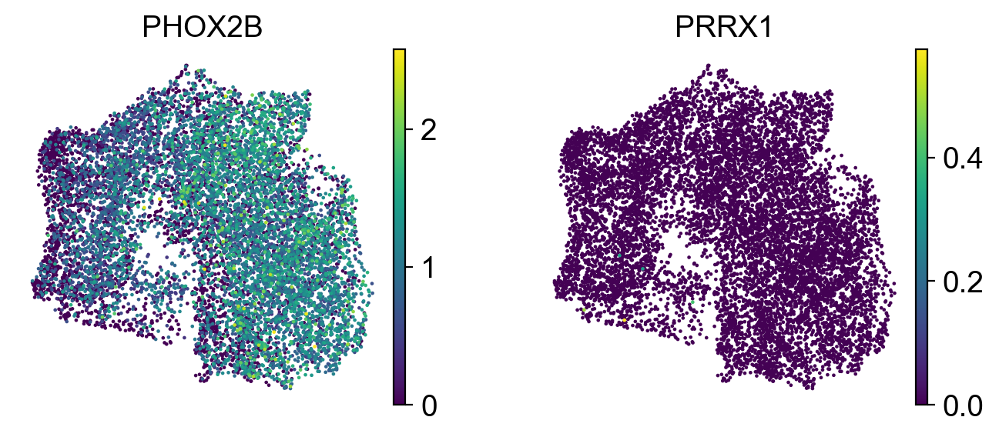

In [17]:
sc.pl.umap(adata, color = ['PHOX2B', 'PRRX1'])

Clustering

In [18]:
sc.tl.leiden(adata, resolution = 0.2)

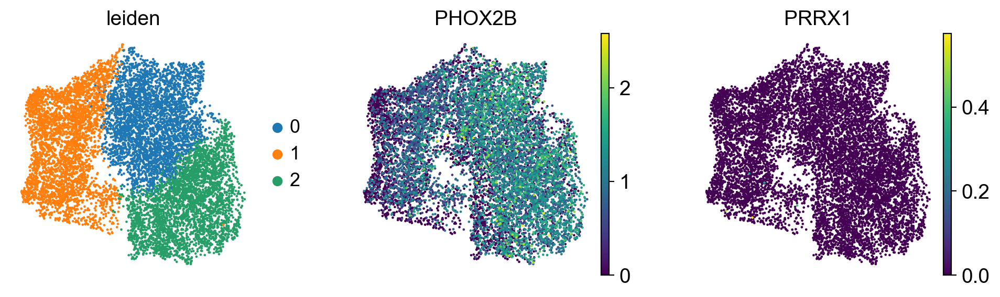

In [19]:
sc.pl.umap(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

In [20]:
adata.write_h5ad(
    datadir+"nb039_entry_scanpy.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

Marker genes

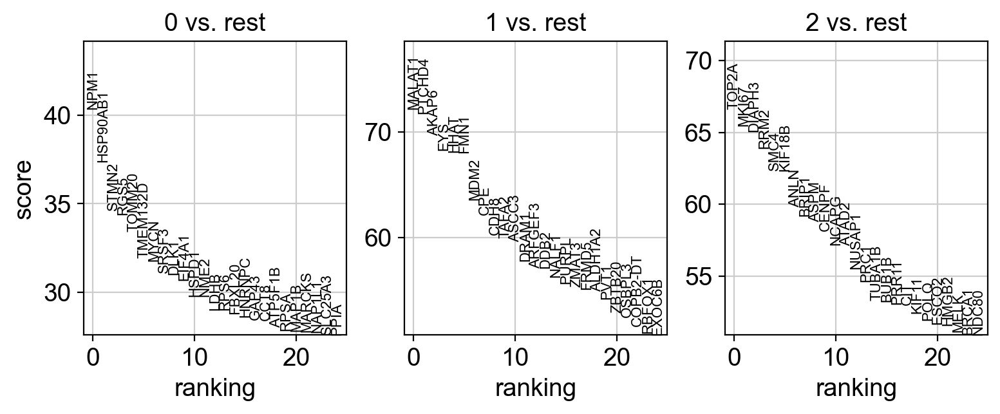

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method = 'wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes = 25, sharey = False)

PAGA analysis

In [22]:
adata = sc.read(datadir+"nb039_entry_scanpy.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


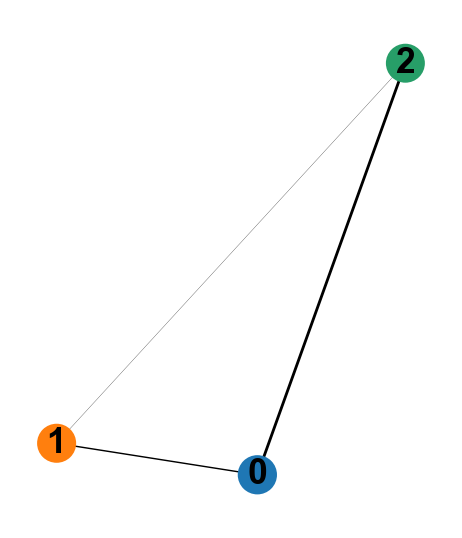

In [31]:
sc.tl.paga(adata, groups = 'leiden')
sc.pl.paga(adata)

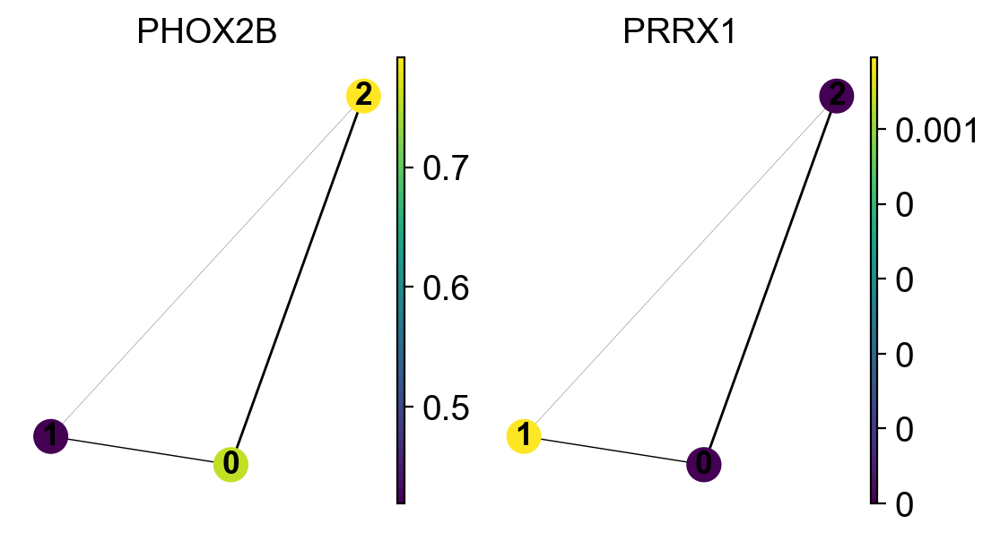

In [36]:
sc.pl.paga(adata, color=['PHOX2B', 'PRRX1'])

### Mutrans analysis

In [37]:
sc.tl.tsne(adata, n_pcs = 30)

In [38]:
sc.pp.neighbors(adata, metric = 'cosine', n_neighbors = 60, use_rep = 'X')

In [39]:
adata.write_h5ad(
    datadir+"nb039_entry_scanpy_nn.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

#### Start run from here

In [40]:
plotdir = "../plots/nb039_entry/"

In [41]:
adata = sc.read(datadir+"nb039_entry_scanpy_nn.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [42]:
gc.collect()

135167

In [43]:
par = {"choice_distance":"cosine","K_cluster":3.0,"trials":50,"weight_scale":True,"initial":"pca","reduce_large_scale":True,"reduce_num_meta_cell":1000.0,"fig_name": plotdir+"dynam_out"} 
adata_mu = pm.dynamical_analysis(adata, par)
out = adata_mu.uns['da_out']
ind = np.argsort(np.asarray(out['perm_class']).ravel().astype(int)-1)
labels_in_meta = np.asarray(out['reduce_class']).ravel().astype(int)-1
attractor_meta = np.asarray(out['class_order']).ravel()[ind]-1
adata_mu.obs['attractor'] = [ int(attractor_meta[labels_in_meta[i]]) for i in range(len(labels_in_meta))]
entropy_meta = np.asarray(out['H']).ravel()[ind]
adata_mu.obs['entropy'] = [entropy_meta[labels_in_meta[i]] for i in range(len(labels_in_meta))]

In [44]:
adata_mu

AnnData object with n_obs × n_vars = 10740 × 2523
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'attractor', 'entropy'
    var: 'features', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'tsne', 'umap', 'da_out', 'land'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'seurat_lognorm'
    obsp: 'connectivities', 'distances'

In [3]:
np.asarray(adata_mu.uns['da_out']['mu_hat'])

array([[0.53405929],
       [0.16971768],
       [0.29622303]])

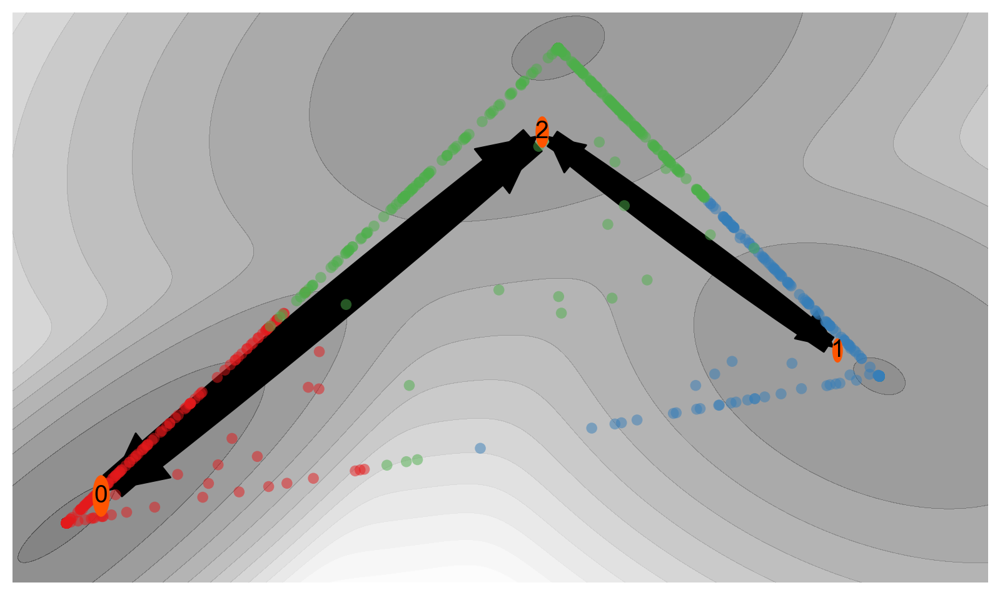

In [46]:
fig = plt.figure(figsize = (10, 6))
pm.infer_lineage(adata_mu, method = "MPFT", size_point = 40, alpha_point = 0.5, size_text = 15)
plt.savefig(plotdir+"nb039_entry_mpft.pdf")
plt.savefig(plotdir+"nb039_entry_mpft.png")

MPPT from 0 to 1

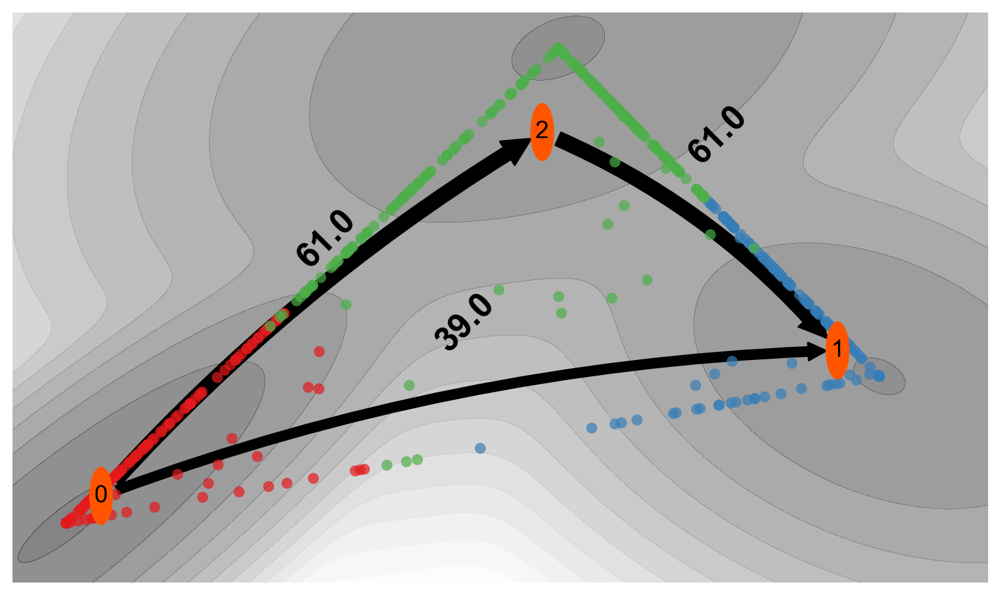

In [47]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 1, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_entry_mppt_0_to_1_100.pdf")
plt.savefig(plotdir+"nb039_entry_mppt_0_to_1_100.png")

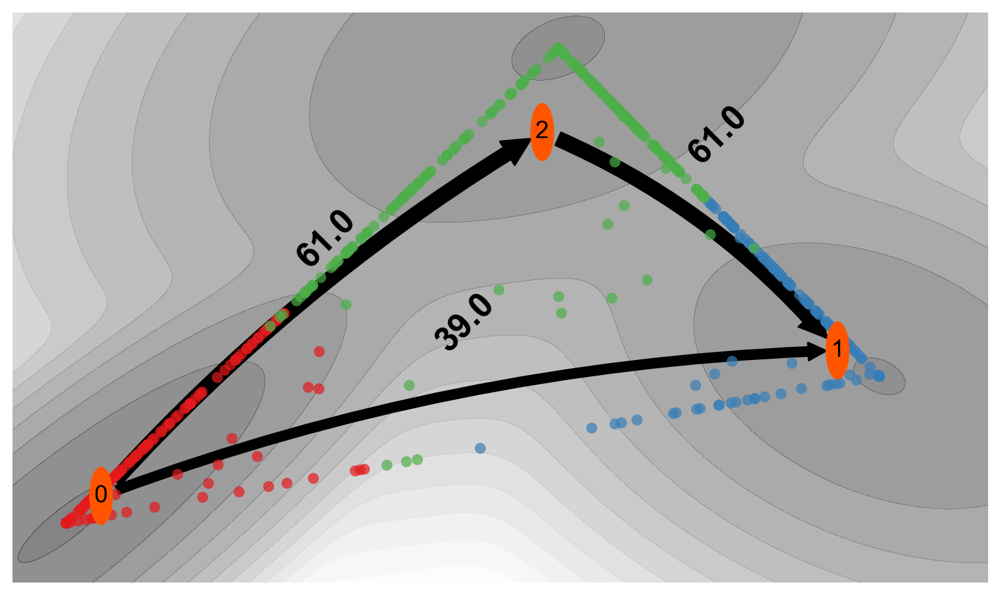

In [48]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 1, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_entry_mppt_0_to_1_90.pdf")
plt.savefig(plotdir+"nb039_entry_mppt_0_to_1_90.png")

MPPT from 1 to 0

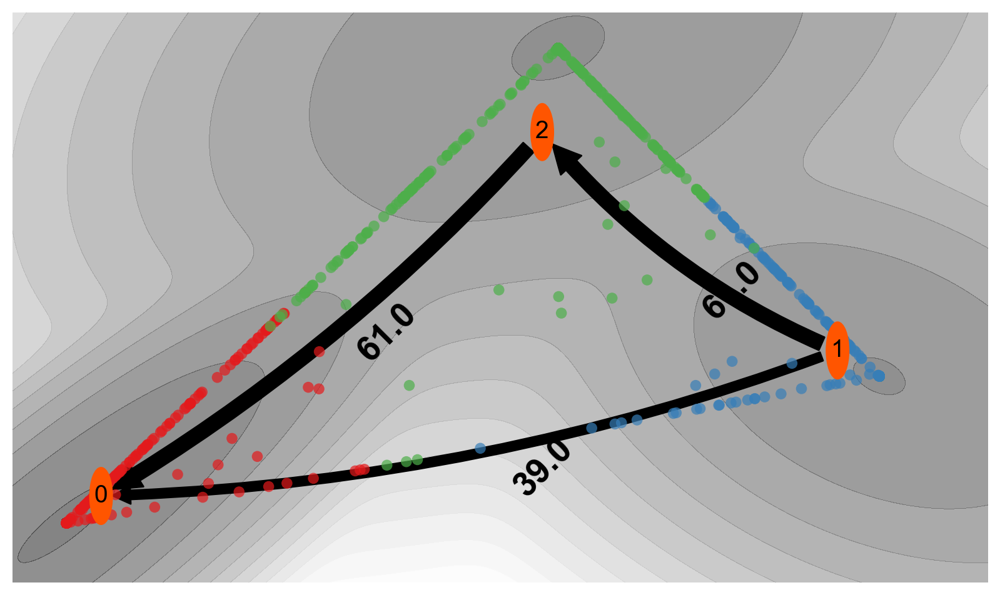

In [49]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 0, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_entry_mppt_1_to_0_100.pdf")
plt.savefig(plotdir+"nb039_entry_mppt_1_to_0_100.png")

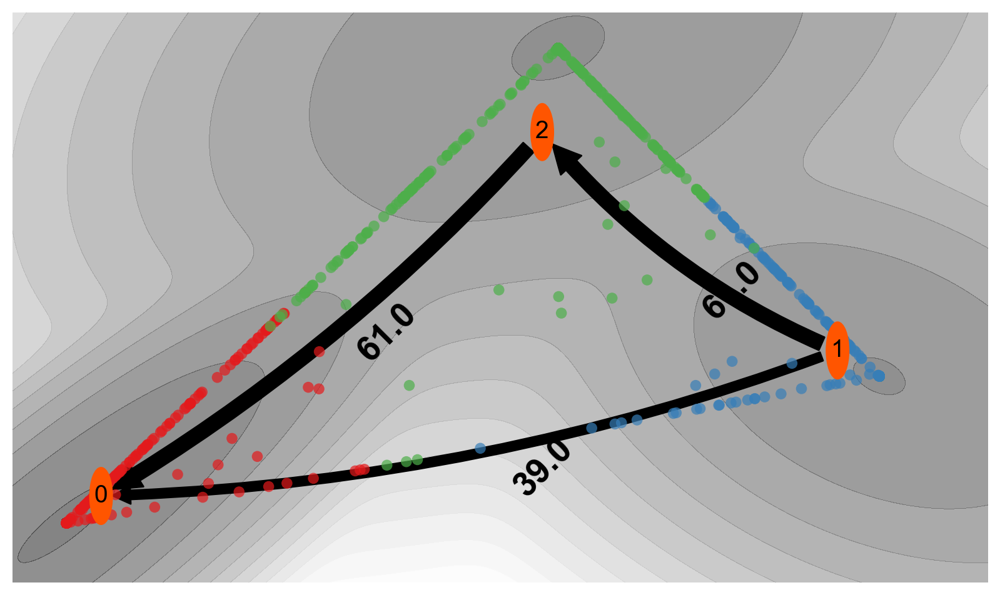

In [50]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 0, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_entry_mppt_1_to_0_90.pdf")
plt.savefig(plotdir+"nb039_entry_mppt_1_to_0_90.png")

In [51]:
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')

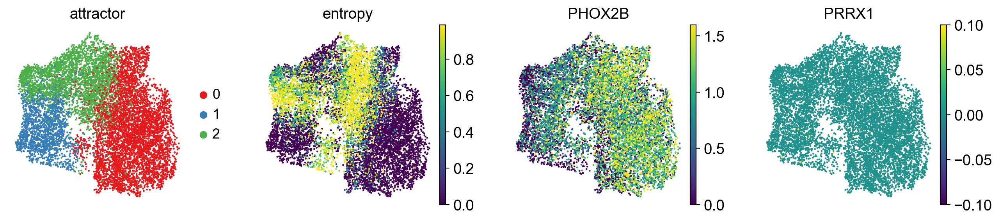

In [52]:
color_palette = sns.color_palette('Set1', 3)
sc.pl.umap(adata_mu, color = ['attractor', 'entropy', 'PHOX2B', 'PRRX1'], vmax = 'p95', palette = color_palette, show = False)
plt.savefig(plotdir+"nb039_entry_umap_attractor_entropy.pdf")
plt.savefig(plotdir+"nb039_entry_umap_attractor_entropy.png")

In [53]:
for keys in list(adata_mu.uns['da_out'].keys()):
    if type(adata_mu.uns['da_out'][keys]).__name__ == 'double':
        adata_mu.uns['da_out'][keys] = np.asarray(adata_mu.uns['da_out'][keys])    

for keys in list(adata_mu.uns['land'].keys()):
    if type(adata_mu.uns['land'][keys]).__name__ == 'double':
        adata_mu.uns['land'][keys] = np.asarray(adata_mu.uns['land'][keys])    

del adata_mu.uns['land']['model']

adata_mu.write(datadir+'nb039_entry_mutrans.h5ad')

In [54]:
del adata_mu.uns['da_out']
del adata_mu.uns['land']

In [55]:
adata_mu.write_h5ad(
    datadir+"nb039_entry_mutrans_mod.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

### Attractor annotation

In [2]:
plotdir = "../plots/nb039_entry/"

In [3]:
adata_mu = sc.read(datadir+'nb039_entry_mutrans.h5ad')
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')
color_palette = sns.color_palette('Set1', 3)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [4]:
conditions = [
    adata_mu.obs['attractor'] == 0,
    adata_mu.obs['attractor'] == 1,
    adata_mu.obs['attractor'] == 2
]

outputs = [
    'I', 'III', 'II'
]

In [5]:
adata_mu.obs['energy_rank'] = np.select(conditions, outputs)

In [5]:
energy_pal = {
    'I' : color_palette[0],
    'II' : color_palette[2],
    'III' : color_palette[1]
}

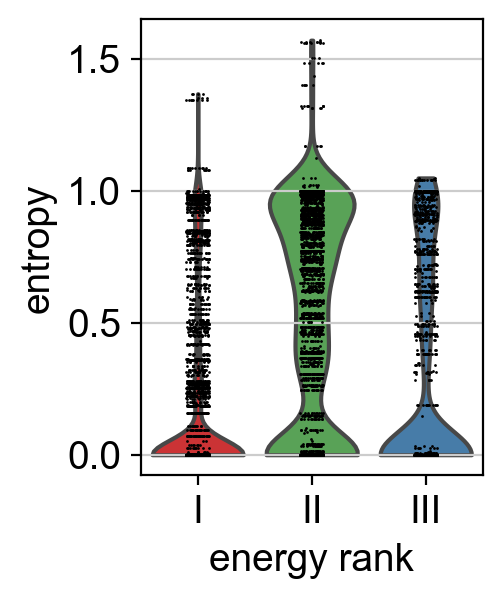

In [7]:
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
sc.pl.violin(adata_mu, keys = 'entropy', groupby='energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_entry_violin_attractor_entropy_ranked.pdf")
plt.savefig(plotdir+"nb039_entry_violin_attractor_entropy_ranked.png")

[<Axes:xlabel='energy rank', ylabel='VIM'>,
 <Axes:xlabel='energy rank', ylabel='PHOX2B'>,
 <Axes:xlabel='energy rank', ylabel='GATA2'>,
 <Axes:xlabel='energy rank', ylabel='PRRX1'>,
 <Axes:xlabel='energy rank', ylabel='CD24'>,
 <Axes:xlabel='energy rank', ylabel='CD44'>,
 <Axes:xlabel='energy rank', ylabel='SOX6'>,
 <Axes:xlabel='energy rank', ylabel='SOX11'>]

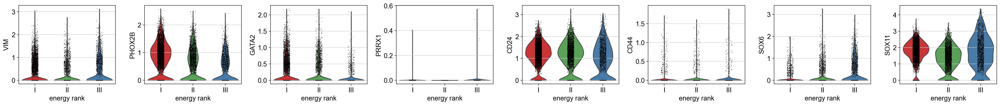

In [45]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['VIM','PHOX2B','GATA2','PRRX1','CD24','CD44','SOX6','SOX11'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_entry_violin_markers_ranked.pdf")
plt.savefig(plotdir+"nb039_entry_violin_markers_ranked.png")

In [9]:
adata_mu.write_h5ad(
    datadir+"nb039_entry_mutrans_ranked.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

#### Hybrid signature

In [46]:
plotdir = "../plots/nb039_entry/"
adata_mu = sc.read(datadir+'nb039_entry_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [10]:
hyb_sig = pd.read_csv(datadir+"method2_dge.csv")

In [11]:
hyb_list = hyb_sig['gene'].tolist()

In [12]:
sc.tl.score_genes(adata_mu, gene_list=hyb_list, ctrl_size=len(hyb_list), score_name="HYB.Sig")

In [17]:
color_palette = sns.color_palette('Set1', 3)
energy_pal = {
    'I' : color_palette[0],
    'II' : color_palette[2],
    'III' : color_palette[1]
}

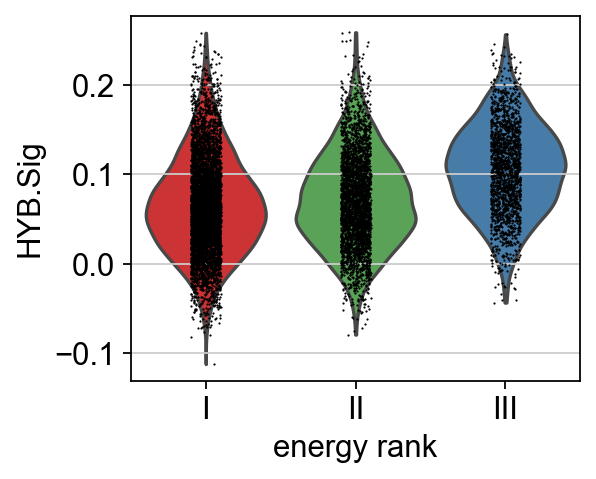

In [13]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = 'HYB.Sig', groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_entry_violin_hyb_ranked.pdf")
plt.savefig(plotdir+"nb039_entry_violin_hyb_ranked.png")

#### Dyer signature

In [ ]:
plotdir = "../plots/nb039_entry/"
adata_mu = sc.read(datadir+'nb039_entry_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [ ]:
color_palette = sns.color_palette('Set1', 3)
energy_pal = {
    'I' : color_palette[0],
    'II' : color_palette[2],
    'III' : color_palette[1]
}

In [48]:
dyer_df = pd.read_csv(datadir+"Dyer_Sig.csv", header=None)
dyer_df.columns = ["Gene", "Signature"]

In [59]:
dyer_sig = {sig: dyer_df[dyer_df['Signature'] == sig]['Gene'].tolist() for sig in dyer_df['Signature'].unique()}
gene_lists = list(dyer_sig.values())

In [60]:
for gene_list, score_name in zip(gene_lists, ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer']):
    sc.tl.score_genes(adata_mu, gene_list=gene_list, score_name=score_name, random_state=12345)

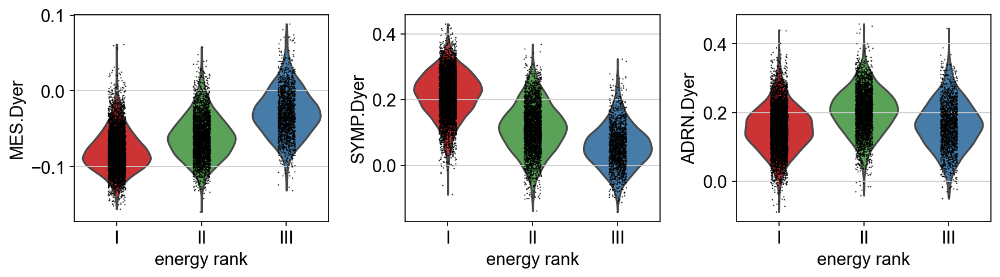

In [65]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_entry_violin_dyer_ranked.pdf")
plt.savefig(plotdir+"nb039_entry_violin_dyer_ranked.png")

## NB039 exit

In [14]:
import pandas as pd
import numpy as np
import scanpy as sc
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
import matplotlib.pyplot as plt
import pyMuTrans as pm
import hdf5plugin
import gc
import seaborn as sns

datadir = "data/"

In [2]:
adata = sc.read(datadir+'nb039_exit_seurat.h5ad')
adata

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 5217 × 22192
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Barcode', 'CellID', 'sizeFactor', 'description', 'CMO', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'sum', 'detected', 'subsets_mt_sum', 'subsets_mt_detected', 'subsets_mt_percent', 'subsets_linc_sum', 'subsets_linc_detected', 'subsets_linc_percent', 'subsets_ribo_sum', 'subsets_ribo_detected', 'subsets_ribo_percent', 'total', 'Seurat.Phase', 'Seurat.S', 'Seurat.G2M', 'Seurat.Cycle.Score', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.3', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'

In [3]:
adata.layers["raw_counts"] = adata.raw.X
adata.layers["seurat_lognorm"] = adata.X
adata.X = adata.raw.X

In [4]:
adata.obs = adata.obs[['Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig']]
adata.obsm = []
adata

AnnData object with n_obs × n_vars = 5217 × 22192
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'
    layers: 'raw_counts', 'seurat_lognorm'

In [5]:
# Check adata has raw counts matrix
df = pd.DataFrame.sparse.from_spmatrix(adata.X)
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,22182,22183,22184,22185,22186,22187,22188,22189,22190,22191
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0
1,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,9.0,...,6.0,0.0,0.0,0.0,0.0,4.0,0.0,1.0,0.0,9.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0,1.0,3.0,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8,3.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0
9,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,...,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0


### Pre-processing

QC

In [6]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars = ['mt'], percent_top = None, log1p = False, inplace = True)

Normalisation

In [7]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)

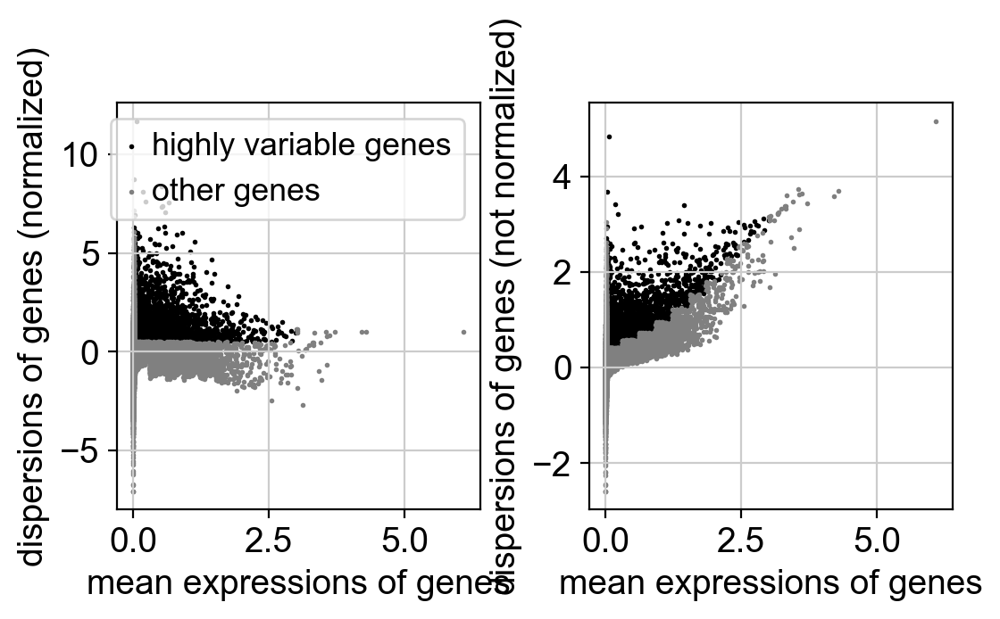

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
# Set .raw attribute of AnnData object to the normalised and logarithmized raw gene expression
adata.raw = adata
# Filter for highly variable genes
adata = adata[:, adata.var.highly_variable]

In [10]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df

In [11]:
sc.pp.scale(adata, max_value = 10) # Clips values exceeding sd = 10

Reduced dims

In [12]:
sc.tl.pca(adata, svd_solver = 'arpack')

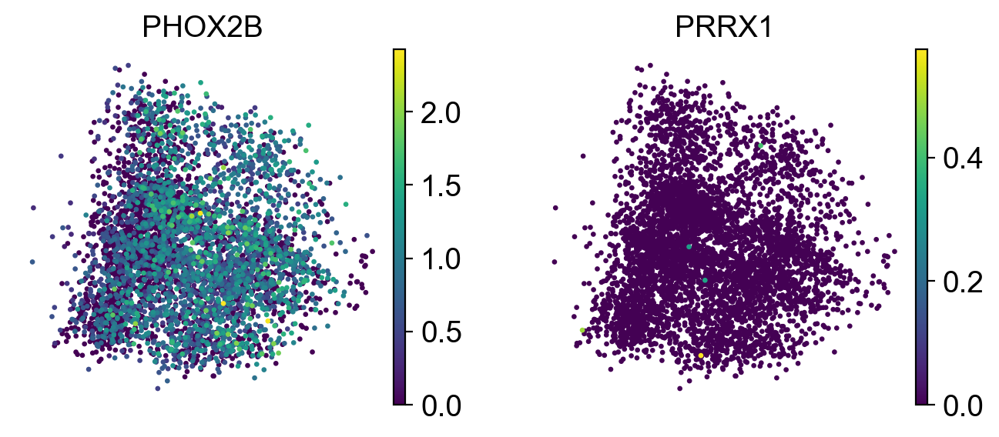

In [13]:
sc.pl.pca(adata, color = ['PHOX2B','PRRX1'])

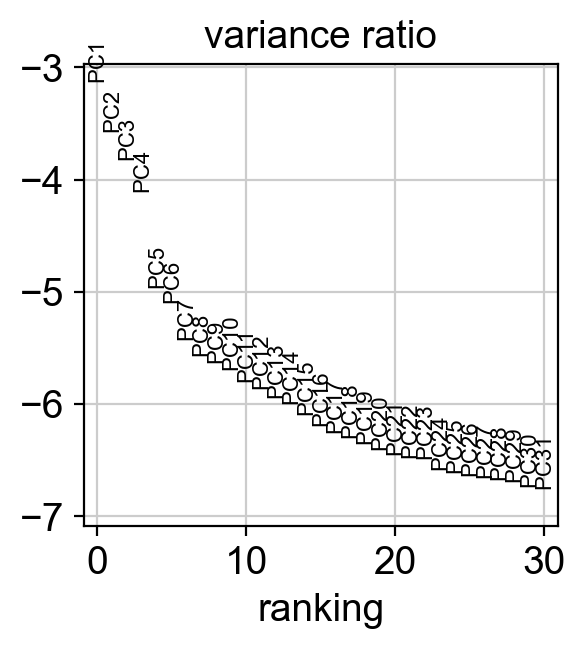

In [14]:
sc.pl.pca_variance_ratio(adata, log = True)

In [15]:
sc.pp.neighbors(adata, n_neighbors = 10, n_pcs = 40)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1086: NumbaD

In [16]:
sc.tl.umap(adata)

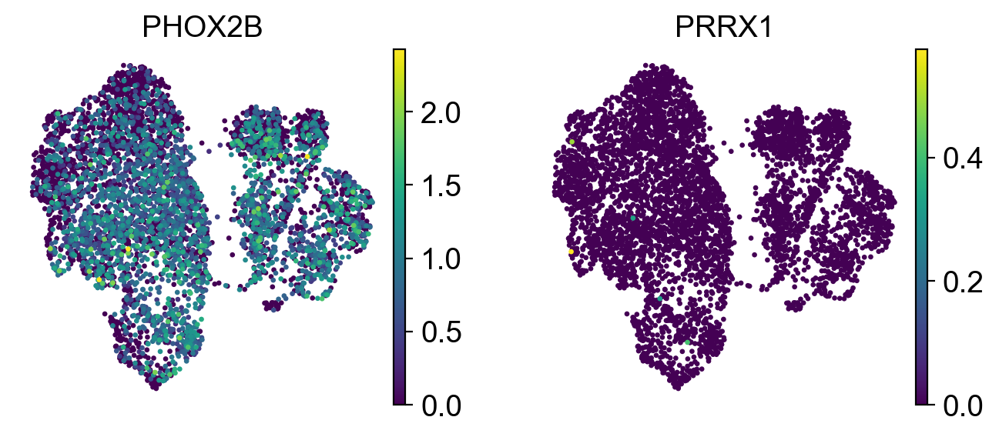

In [17]:
sc.pl.umap(adata, color = ['PHOX2B', 'PRRX1'])

Clustering

In [18]:
sc.tl.leiden(adata, resolution = 0.2)

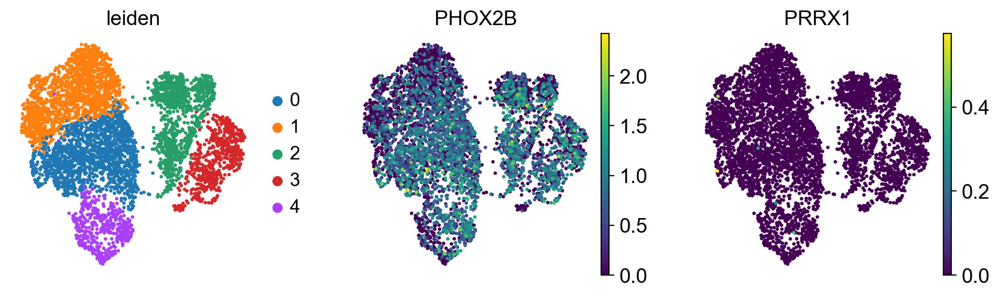

In [19]:
sc.pl.umap(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

In [20]:
adata.write_h5ad(
    datadir+"nb039_exit_scanpy.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

Marker genes

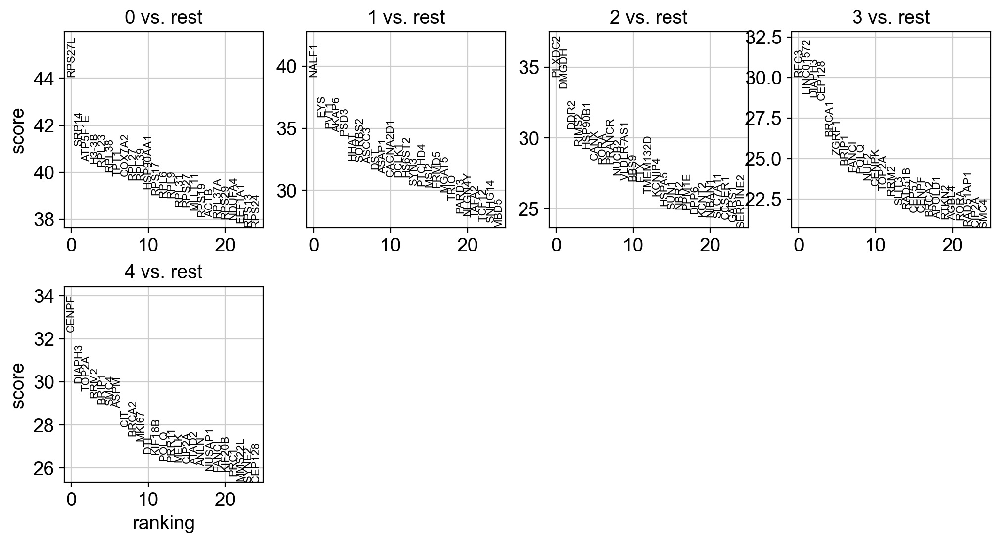

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method = 'wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes = 25, sharey = False)

PAGA analysis

In [22]:
adata = sc.read(datadir+"nb039_exit_scanpy.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


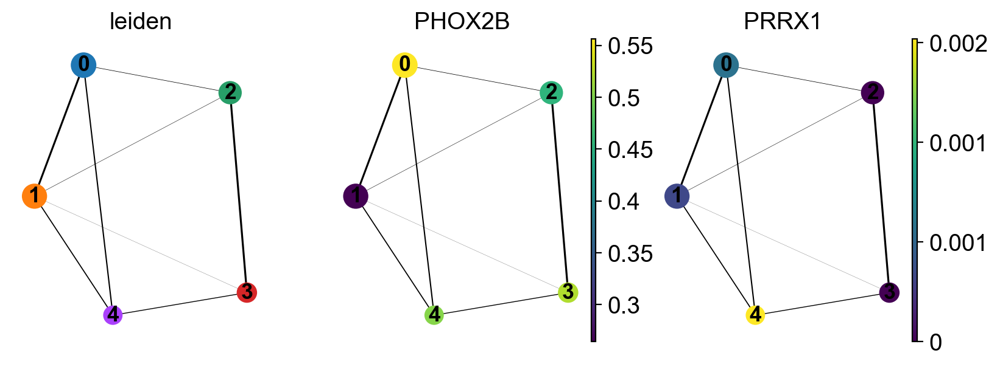

In [23]:
sc.tl.paga(adata, groups = 'leiden')
sc.pl.paga(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

### Mutrans analysis

In [24]:
sc.tl.tsne(adata, n_pcs = 30)

In [25]:
sc.pp.neighbors(adata, metric = 'cosine', n_neighbors = 60, use_rep = 'X')

In [26]:
adata.write_h5ad(
    datadir+"nb039_exit_scanpy_nn.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

#### Start run from here

In [27]:
plotdir = "../plots/nb039_exit/"

In [28]:
adata = sc.read(datadir+"nb039_exit_scanpy_nn.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [29]:
gc.collect()

26630

In [30]:
par = {"choice_distance":"cosine","K_cluster":5.0,"trials":50,"weight_scale":True,"initial":"pca","reduce_large_scale":True,"reduce_num_meta_cell":1000.0,"fig_name": plotdir+"dynam_out"} 
adata_mu = pm.dynamical_analysis(adata, par)
out = adata_mu.uns['da_out']
ind = np.argsort(np.asarray(out['perm_class']).ravel().astype(int)-1)
labels_in_meta = np.asarray(out['reduce_class']).ravel().astype(int)-1
attractor_meta = np.asarray(out['class_order']).ravel()[ind]-1
adata_mu.obs['attractor'] = [ int(attractor_meta[labels_in_meta[i]]) for i in range(len(labels_in_meta))]
entropy_meta = np.asarray(out['H']).ravel()[ind]
adata_mu.obs['entropy'] = [entropy_meta[labels_in_meta[i]] for i in range(len(labels_in_meta))]

In [31]:
adata_mu

AnnData object with n_obs × n_vars = 5217 × 3028
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'attractor', 'entropy'
    var: 'features', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'tsne', 'umap', 'da_out', 'land'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'seurat_lognorm'
    obsp: 'connectivities', 'distances'

In [5]:
np.asarray(adata_mu.uns['da_out']['mu_hat'])

array([[0.2412682 ],
       [0.35451538],
       [0.12892396],
       [0.22049262],
       [0.05479984]])

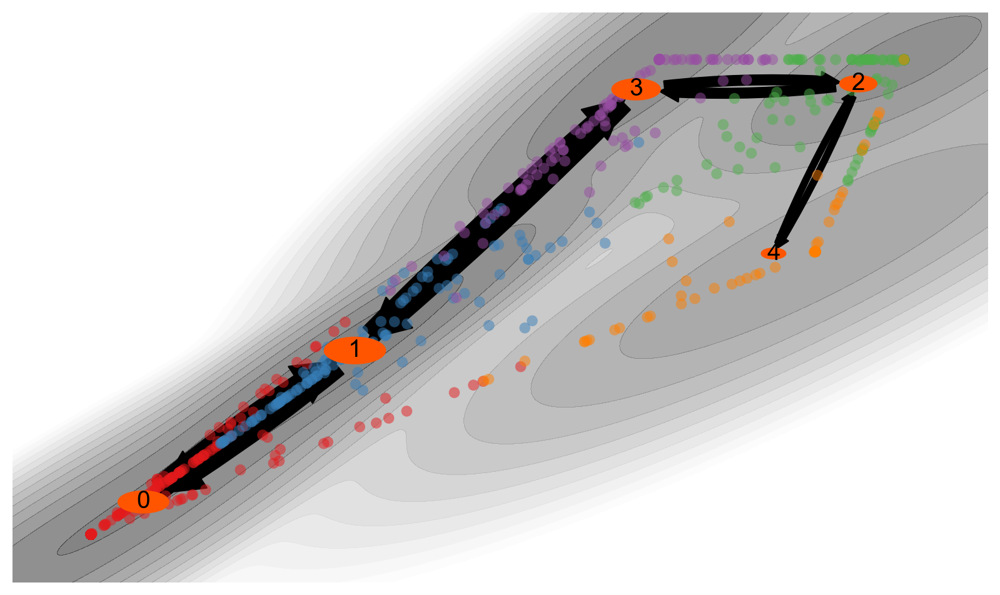

In [33]:
fig = plt.figure(figsize = (10, 6))
pm.infer_lineage(adata_mu, method = "MPFT", size_point = 40, alpha_point = 0.5, size_text = 15)
plt.savefig(plotdir+"nb039_exit_mpft.pdf")
plt.savefig(plotdir+"nb039_exit_mpft.png")

MPPT from 0 to 4

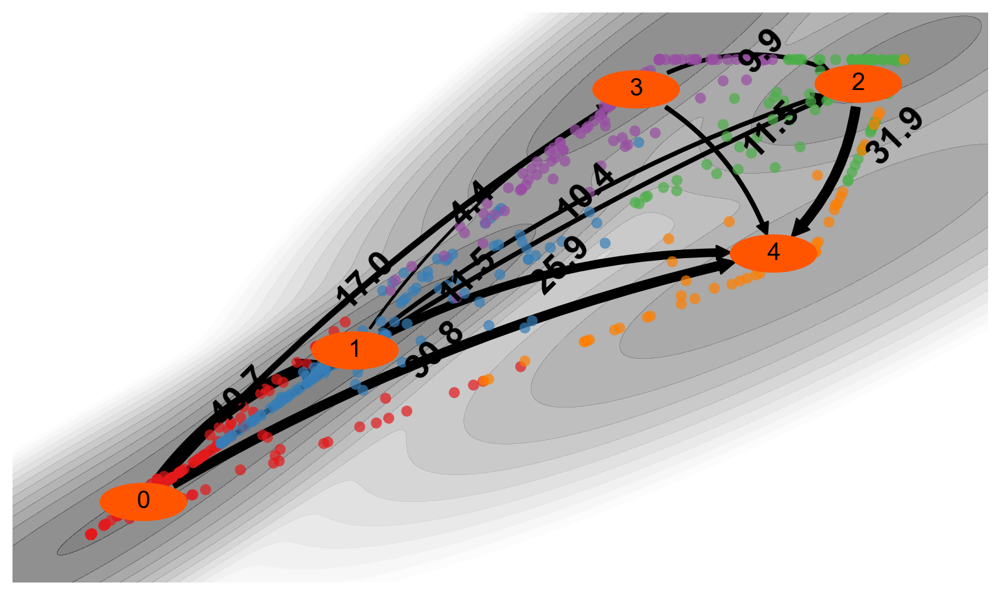

In [34]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 4, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_exit_mppt_0_to_4_100.pdf")
plt.savefig(plotdir+"nb039_exit_mppt_0_to_4_100.png")

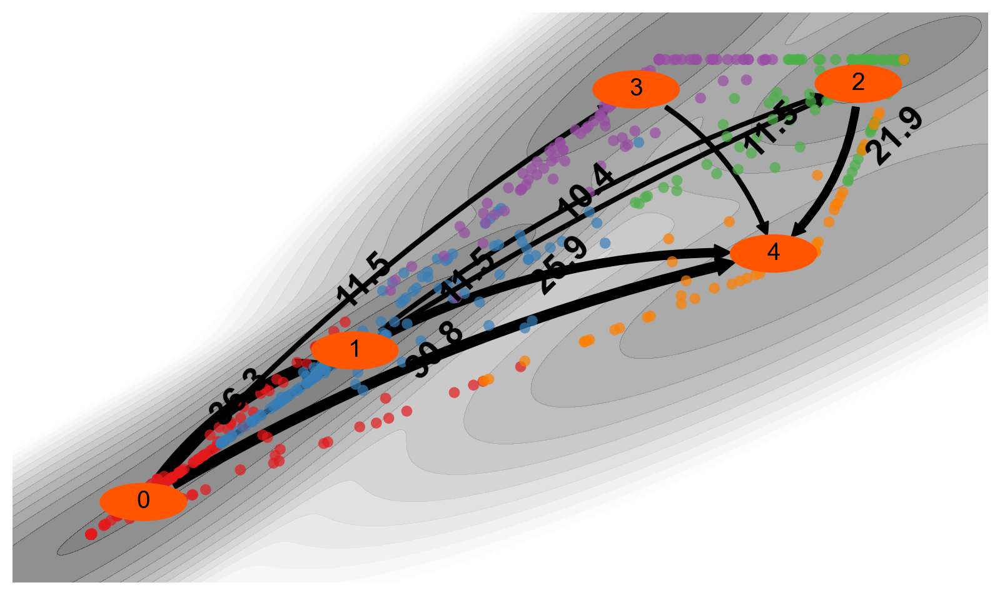

In [35]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 4, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_exit_mppt_0_to_4_90.pdf")
plt.savefig(plotdir+"nb039_exit_mppt_0_to_4_90.png")

MPPT from 4 to 0

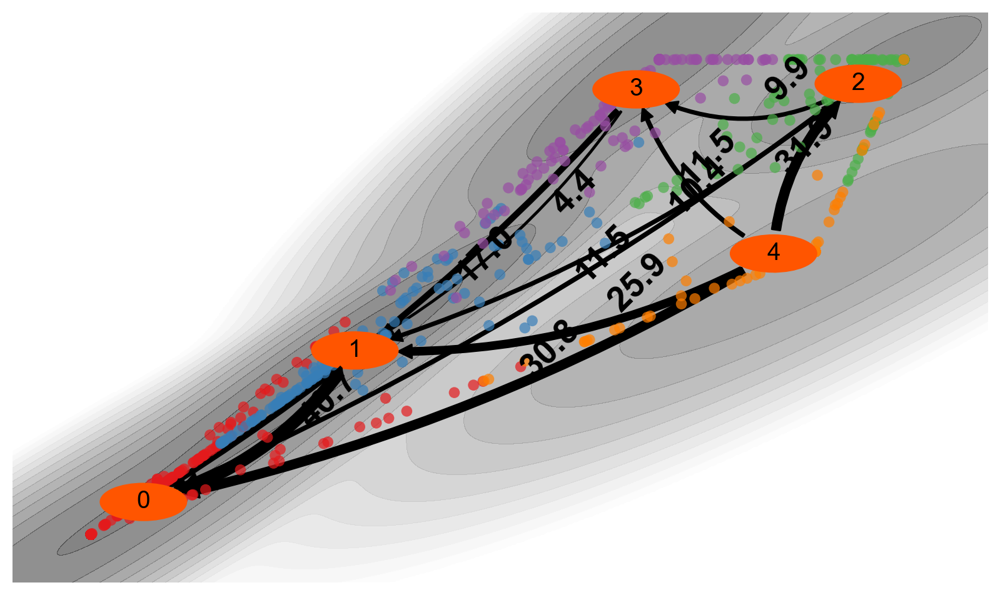

In [36]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 4,sf = 0, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_exit_mppt_4_to_0_100.pdf")
plt.savefig(plotdir+"nb039_exit_mppt_4_to_0_100.png")

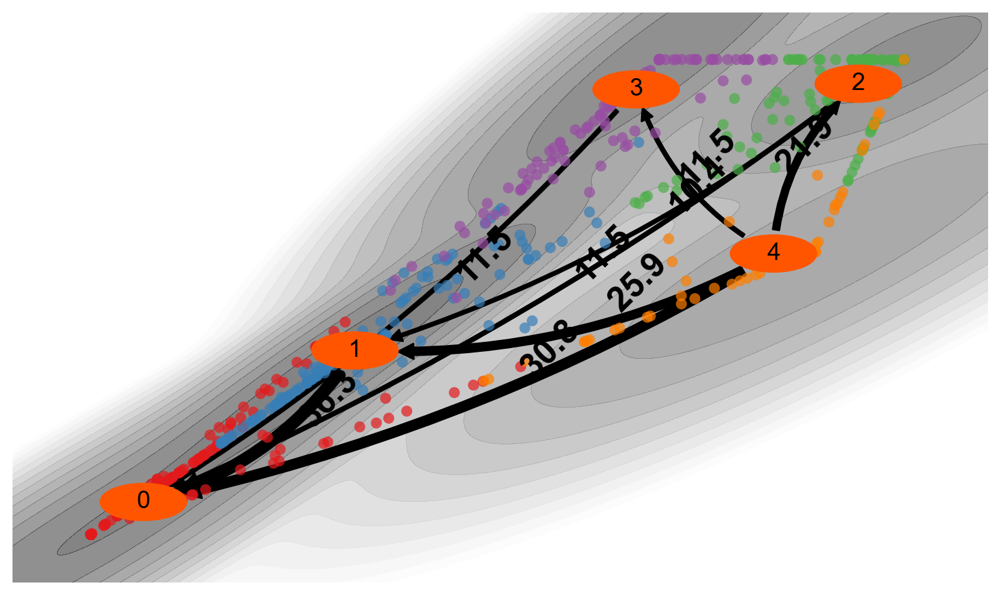

In [37]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 4,sf = 0, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb039_exit_mppt_4_to_0_90.pdf")
plt.savefig(plotdir+"nb039_exit_mppt_4_to_0_90.png")

In [38]:
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')

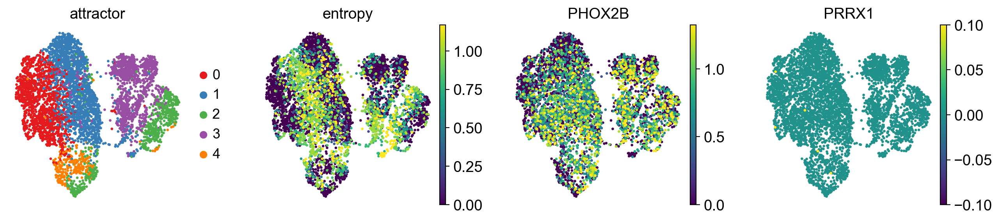

In [39]:
color_palette = sns.color_palette('Set1', 5)
sc.pl.umap(adata_mu, color = ['attractor', 'entropy', 'PHOX2B', 'PRRX1'], vmax = 'p95', palette = color_palette, show = False)
plt.savefig(plotdir+"nb039_exit_umap_attractor_entropy.pdf")
plt.savefig(plotdir+"nb039_exit_umap_attractor_entropy.png")

In [40]:
for keys in list(adata_mu.uns['da_out'].keys()):
    if type(adata_mu.uns['da_out'][keys]).__name__ == 'double':
        adata_mu.uns['da_out'][keys] = np.asarray(adata_mu.uns['da_out'][keys])    

for keys in list(adata_mu.uns['land'].keys()):
    if type(adata_mu.uns['land'][keys]).__name__ == 'double':
        adata_mu.uns['land'][keys] = np.asarray(adata_mu.uns['land'][keys])    

del adata_mu.uns['land']['model']

adata_mu.write(datadir+'nb039_exit_mutrans.h5ad')

In [41]:
del adata_mu.uns['da_out']
del adata_mu.uns['land']

In [42]:
adata_mu.write_h5ad(
    datadir+"nb039_exit_mutrans_mod.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

### Attractor annotation

In [15]:
plotdir = "../plots/nb039_exit/"

In [16]:
adata_mu = sc.read(datadir+'nb039_exit_mutrans.h5ad')
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')
color_palette = sns.color_palette('Set1', 5)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [17]:
conditions = [
    adata_mu.obs['attractor'] == 0,
    adata_mu.obs['attractor'] == 1,
    adata_mu.obs['attractor'] == 2,
    adata_mu.obs['attractor'] == 3,
    adata_mu.obs['attractor'] == 4
]

outputs = [
    'II', 'I', 'IV', 'III', 'V'
]

In [18]:
adata_mu.obs['energy_rank'] = np.select(conditions, outputs)

In [19]:
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[2],
    'V' : color_palette[4]
}

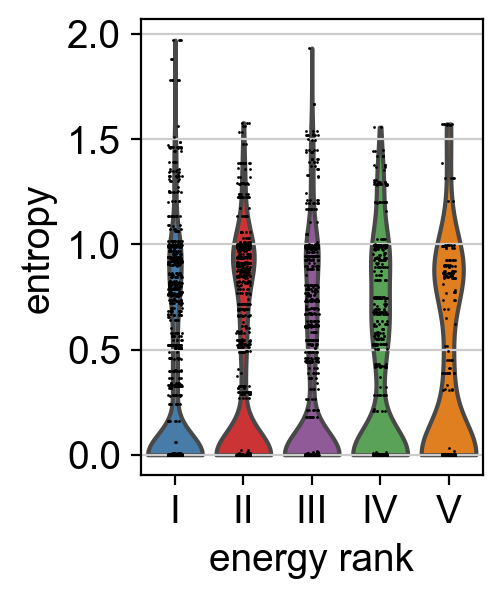

In [20]:
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
sc.pl.violin(adata_mu, keys = 'entropy', groupby='energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_exit_violin_attractor_entropy_ranked.pdf")
plt.savefig(plotdir+"nb039_exit_violin_attractor_entropy_ranked.png")

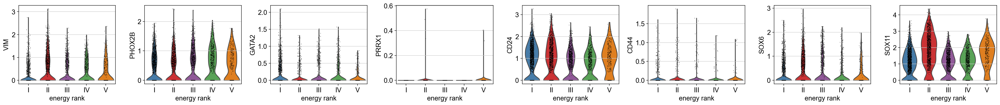

In [21]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['VIM','PHOX2B','GATA2','PRRX1','CD24','CD44','SOX6','SOX11'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_exit_violin_markers_ranked.pdf")
plt.savefig(plotdir+"nb039_exit_violin_markers_ranked.png")

In [22]:
adata_mu.write_h5ad(
    datadir+"nb039_exit_mutrans_ranked.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

#### Hybrid signature

In [ ]:
plotdir = "../plots/nb039_exit/"
adata_mu = sc.read(datadir+'nb039_exit_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [23]:
hyb_sig = pd.read_csv(datadir+"method2_dge.csv")

In [24]:
hyb_list = hyb_sig['gene'].tolist()

In [25]:
sc.tl.score_genes(adata_mu, gene_list=hyb_list, ctrl_size=len(hyb_list), score_name="HYB.Sig")

In [ ]:
color_palette = sns.color_palette('Set1', 5)
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[2],
    'V' : color_palette[4]
}

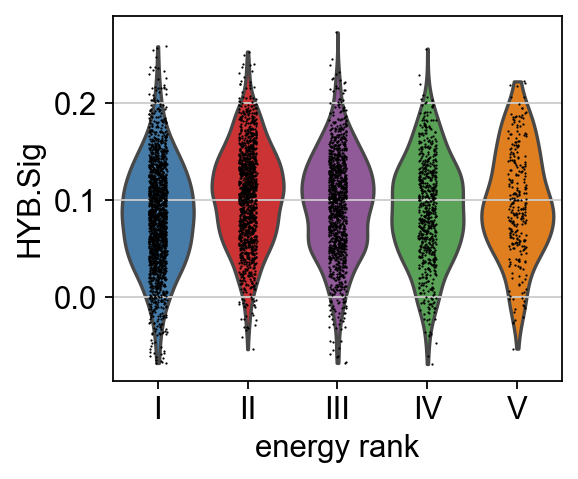

In [26]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = 'HYB.Sig', groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_exit_violin_hyb_ranked.pdf")
plt.savefig(plotdir+"nb039_exit_violin_hyb_ranked.png")

#### Dyer signature

In [66]:
plotdir = "../plots/nb039_exit/"
adata_mu = sc.read(datadir+'nb039_exit_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [67]:
color_palette = sns.color_palette('Set1', 5)
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[2],
    'V' : color_palette[4]
}

In [68]:
dyer_df = pd.read_csv(datadir+"Dyer_Sig.csv", header=None)
dyer_df.columns = ["Gene", "Signature"]

In [69]:
dyer_sig = {sig: dyer_df[dyer_df['Signature'] == sig]['Gene'].tolist() for sig in dyer_df['Signature'].unique()}
gene_lists = list(dyer_sig.values())

In [70]:
for gene_list, score_name in zip(gene_lists, ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer']):
    sc.tl.score_genes(adata_mu, gene_list=gene_list, score_name=score_name, random_state=12345)

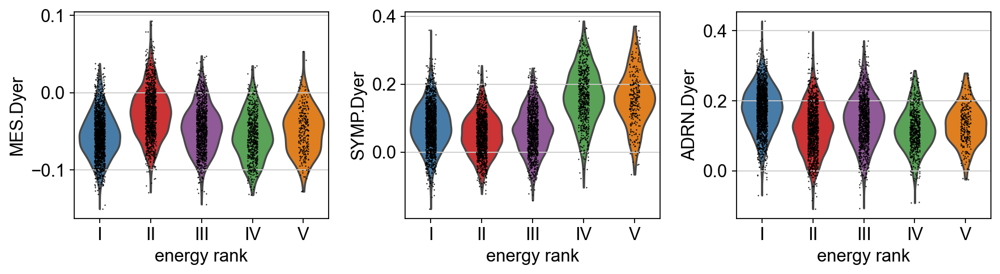

In [71]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb039_exit_violin_dyer_ranked.pdf")
plt.savefig(plotdir+"nb039_exit_violin_dyer_ranked.png")

## NB067 entry

In [27]:
import pandas as pd
import numpy as np
import scanpy as sc
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
import matplotlib.pyplot as plt
import pyMuTrans as pm
import hdf5plugin
import gc
import seaborn as sns

datadir = "data/"

In [2]:
adata = sc.read(datadir+'nb067_entry_seurat.h5ad')
adata

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 5613 × 22192
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Barcode', 'CellID', 'sizeFactor', 'description', 'CMO', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'sum', 'detected', 'subsets_mt_sum', 'subsets_mt_detected', 'subsets_mt_percent', 'subsets_linc_sum', 'subsets_linc_detected', 'subsets_linc_percent', 'subsets_ribo_sum', 'subsets_ribo_detected', 'subsets_ribo_percent', 'total', 'Seurat.Phase', 'Seurat.S', 'Seurat.G2M', 'Seurat.Cycle.Score', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.3', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'

In [3]:
adata.layers["raw_counts"] = adata.raw.X
adata.layers["seurat_lognorm"] = adata.X
adata.X = adata.raw.X

In [4]:
adata.obs = adata.obs[['Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig']]
adata.obsm = []
adata

AnnData object with n_obs × n_vars = 5613 × 22192
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'
    layers: 'raw_counts', 'seurat_lognorm'

In [5]:
# Check adata has raw counts matrix
df = pd.DataFrame.sparse.from_spmatrix(adata.X)
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,22182,22183,22184,22185,22186,22187,22188,22189,22190,22191
0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,3.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Pre-processing

QC

In [6]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars = ['mt'], percent_top = None, log1p = False, inplace = True)

Normalisation

In [7]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)

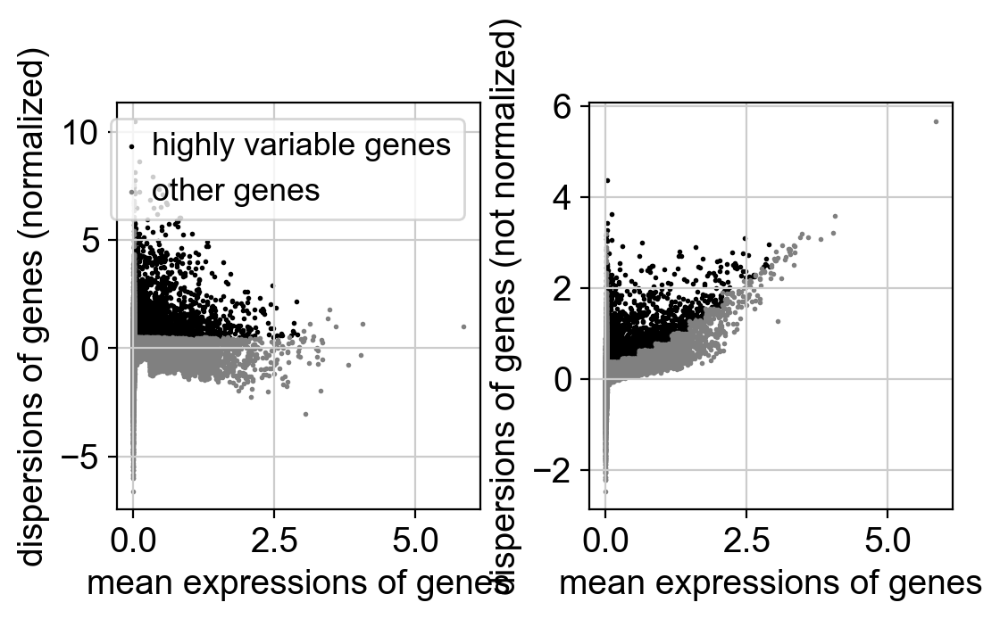

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
# Set .raw attribute of AnnData object to the normalised and logarithmized raw gene expression
adata.raw = adata
# Filter for highly variable genes
adata = adata[:, adata.var.highly_variable]

In [10]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df

In [11]:
sc.pp.scale(adata, max_value = 10) # Clips values exceeding sd = 10

Reduced dims

In [12]:
sc.tl.pca(adata, svd_solver = 'arpack')

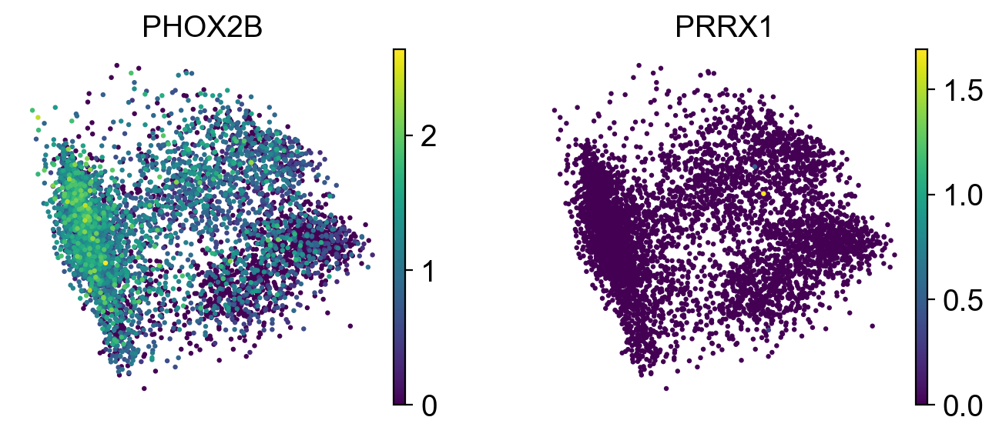

In [13]:
sc.pl.pca(adata, color = ['PHOX2B','PRRX1'])

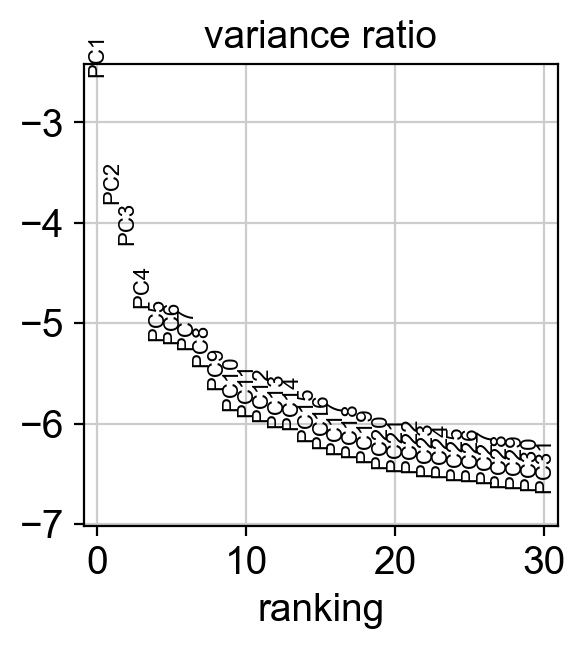

In [14]:
sc.pl.pca_variance_ratio(adata, log = True)

In [15]:
sc.pp.neighbors(adata, n_neighbors = 10, n_pcs = 40)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1086: NumbaD

In [16]:
sc.tl.umap(adata)

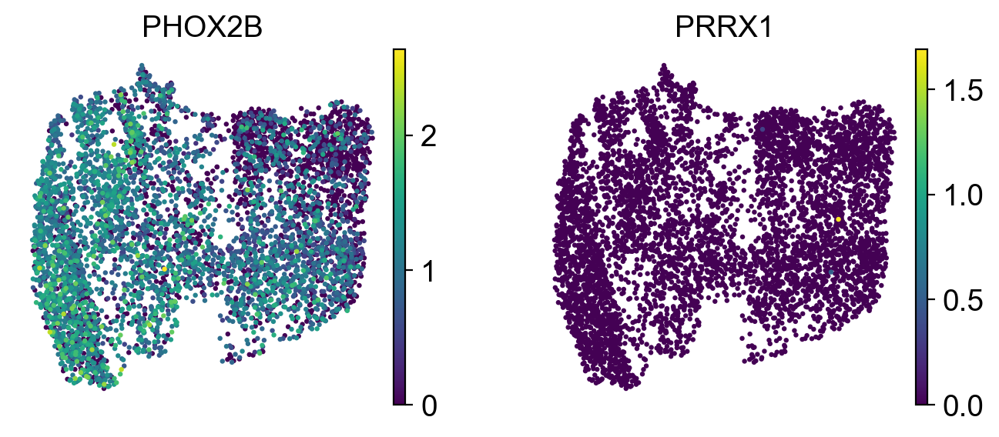

In [17]:
sc.pl.umap(adata, color = ['PHOX2B', 'PRRX1'])

Clustering

In [18]:
sc.tl.leiden(adata, resolution = 0.2)

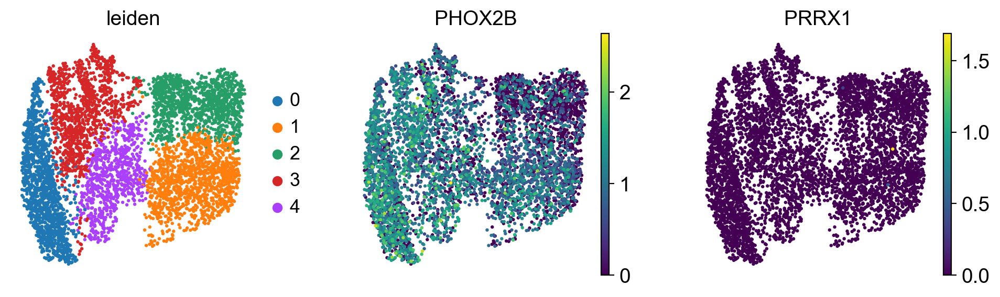

In [19]:
sc.pl.umap(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

In [20]:
adata.write_h5ad(
    datadir+"nb067_entry_scanpy.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

Marker genes

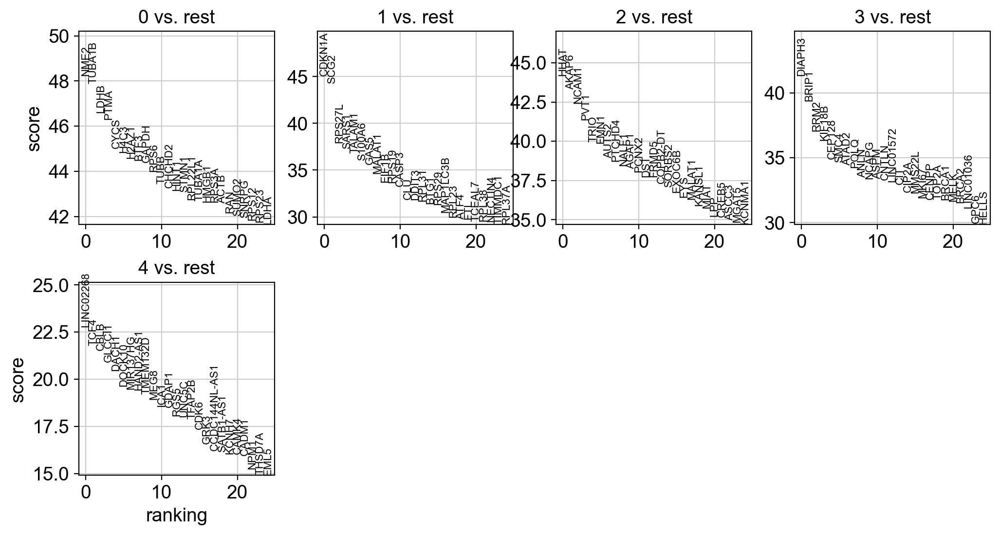

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method = 'wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes = 25, sharey = False)

PAGA analysis

In [22]:
adata = sc.read(datadir+"nb067_entry_scanpy.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


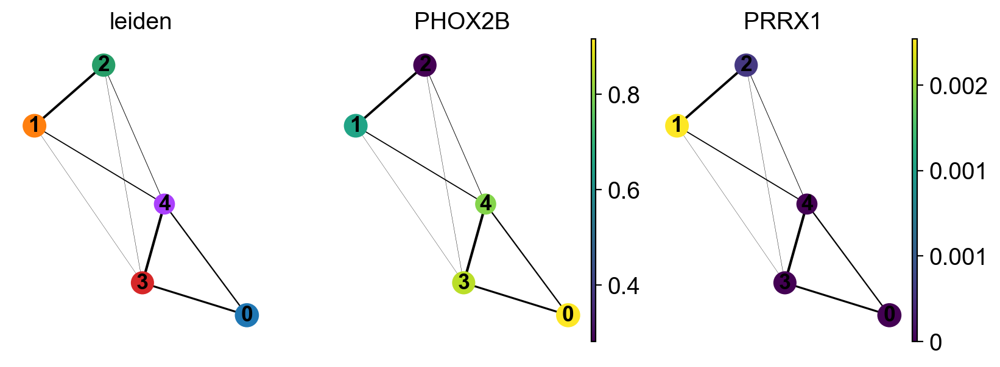

In [23]:
sc.tl.paga(adata, groups = 'leiden')
sc.pl.paga(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

### Mutrans analysis

In [24]:
sc.tl.tsne(adata, n_pcs = 30)

In [25]:
sc.pp.neighbors(adata, metric = 'cosine', n_neighbors = 60, use_rep = 'X')

In [26]:
adata.write_h5ad(
    datadir+"nb067_entry_scanpy_nn.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

#### Start run from here

In [27]:
plotdir = "../plots/nb067_entry/"

In [28]:
adata = sc.read(datadir+"nb067_entry_scanpy_nn.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [29]:
gc.collect()

187075

In [30]:
par = {"choice_distance":"cosine","K_cluster":5.0,"trials":50,"weight_scale":True,"initial":"pca","reduce_large_scale":True,"reduce_num_meta_cell":1000.0,"fig_name": plotdir+"dynam_out"} 
adata_mu = pm.dynamical_analysis(adata, par)
out = adata_mu.uns['da_out']
ind = np.argsort(np.asarray(out['perm_class']).ravel().astype(int)-1)
labels_in_meta = np.asarray(out['reduce_class']).ravel().astype(int)-1
attractor_meta = np.asarray(out['class_order']).ravel()[ind]-1
adata_mu.obs['attractor'] = [ int(attractor_meta[labels_in_meta[i]]) for i in range(len(labels_in_meta))]
entropy_meta = np.asarray(out['H']).ravel()[ind]
adata_mu.obs['entropy'] = [entropy_meta[labels_in_meta[i]] for i in range(len(labels_in_meta))]

In [31]:
adata_mu

AnnData object with n_obs × n_vars = 5613 × 2703
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'attractor', 'entropy'
    var: 'features', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'tsne', 'umap', 'da_out', 'land'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'seurat_lognorm'
    obsp: 'connectivities', 'distances'

In [10]:
np.asarray(adata_mu.uns['da_out']['mu_hat'])

array([[0.24242692],
       [0.11131358],
       [0.44767221],
       [0.19137625],
       [0.00721105]])

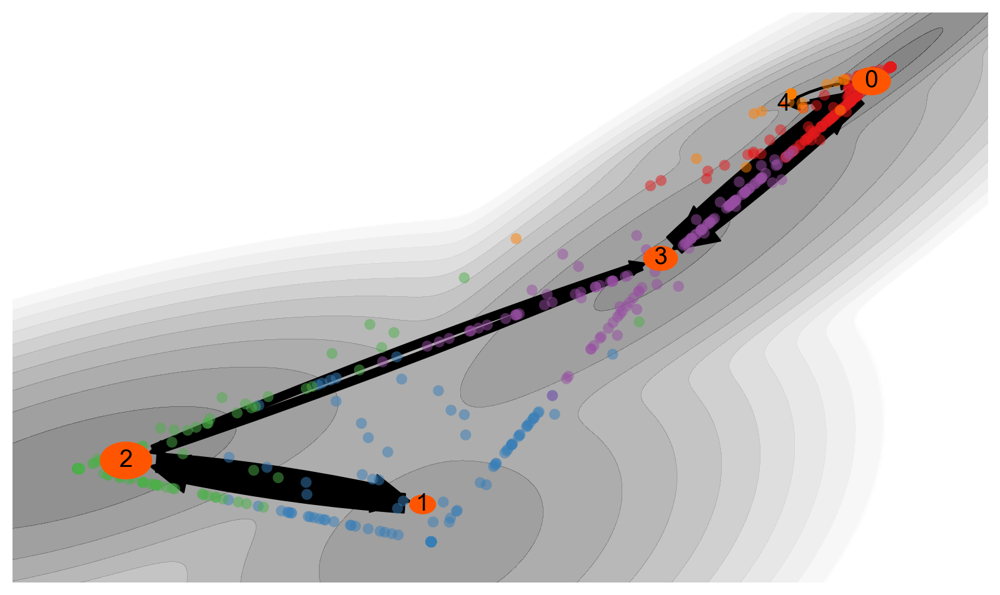

In [33]:
fig = plt.figure(figsize = (10, 6))
pm.infer_lineage(adata_mu, method = "MPFT", size_point = 40, alpha_point = 0.5, size_text = 15)
plt.savefig(plotdir+"nb067_entry_mpft.pdf")
plt.savefig(plotdir+"nb067_entry_mpft.png")

MPPT from 1 to 4

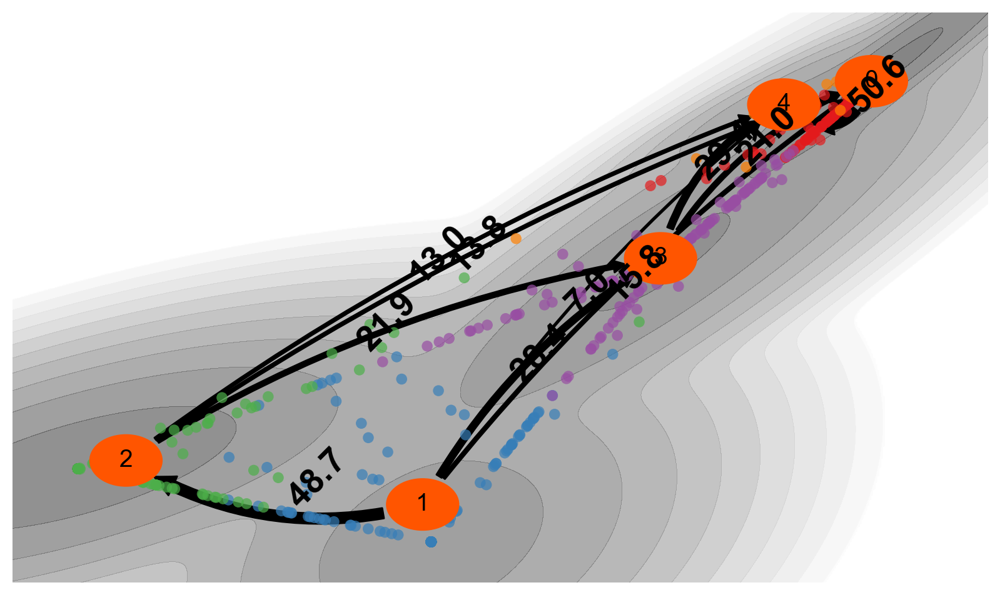

In [34]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 4, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_1_to_4_100.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_1_to_4_100.png")

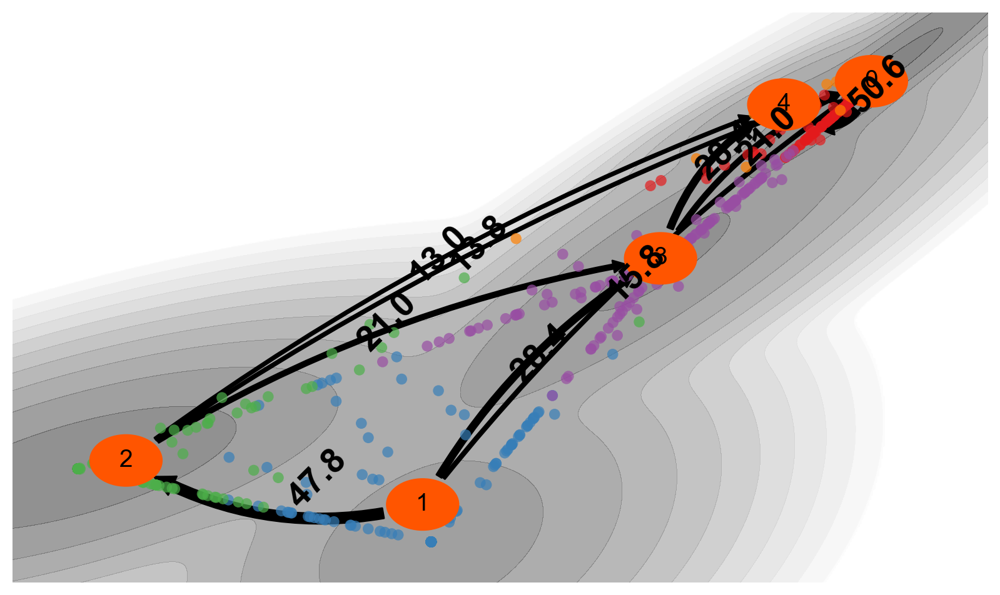

In [35]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 4, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_1_to_4_90.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_1_to_4_90.png")

MPPT from 1 to 0

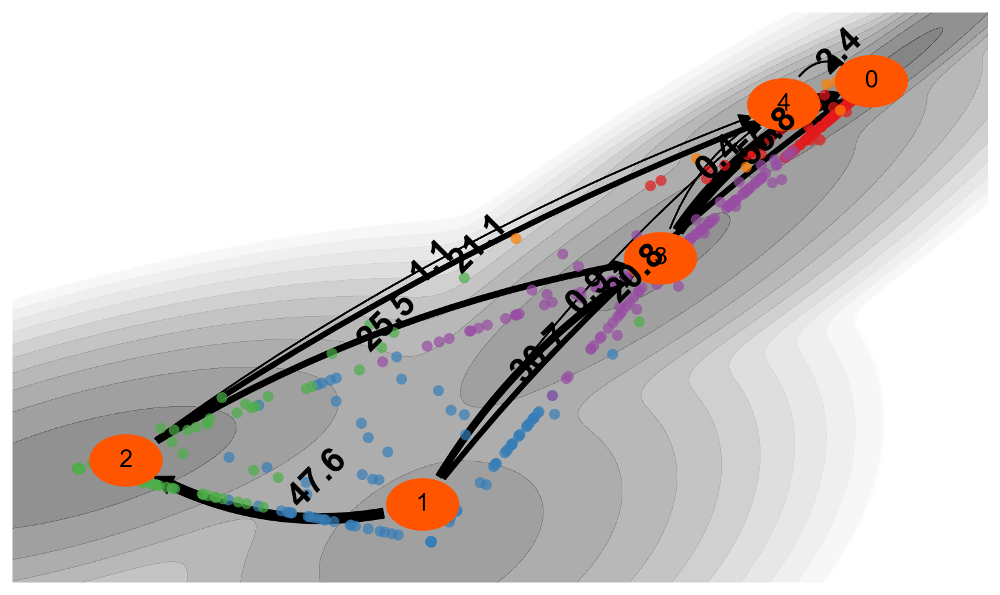

In [36]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 0, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_1_to_0_100.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_1_to_0_100.png")

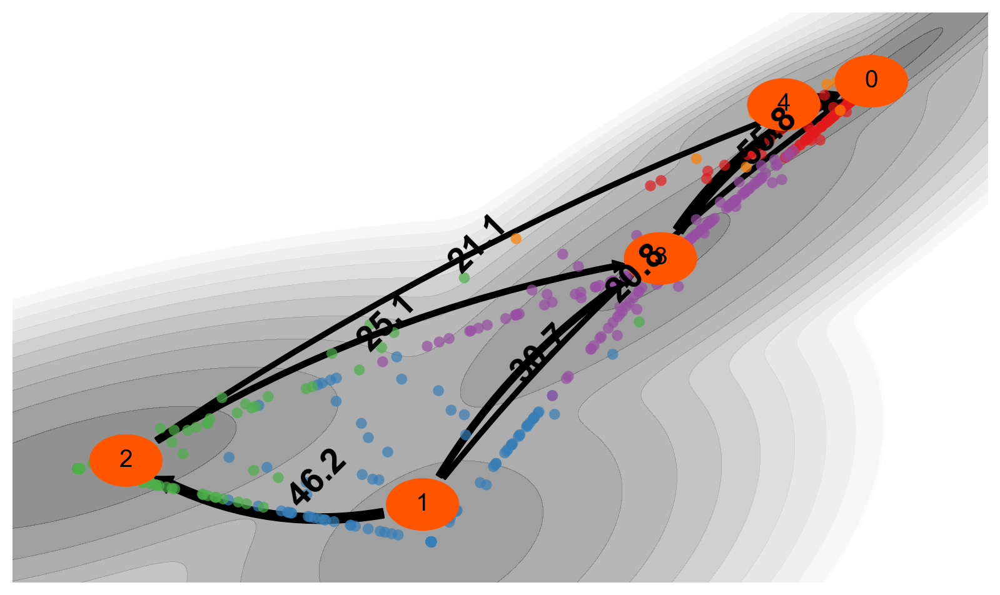

In [37]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 1,sf = 0, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_1_to_0_90.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_1_to_0_90.png")

MPPT from 4 to 1

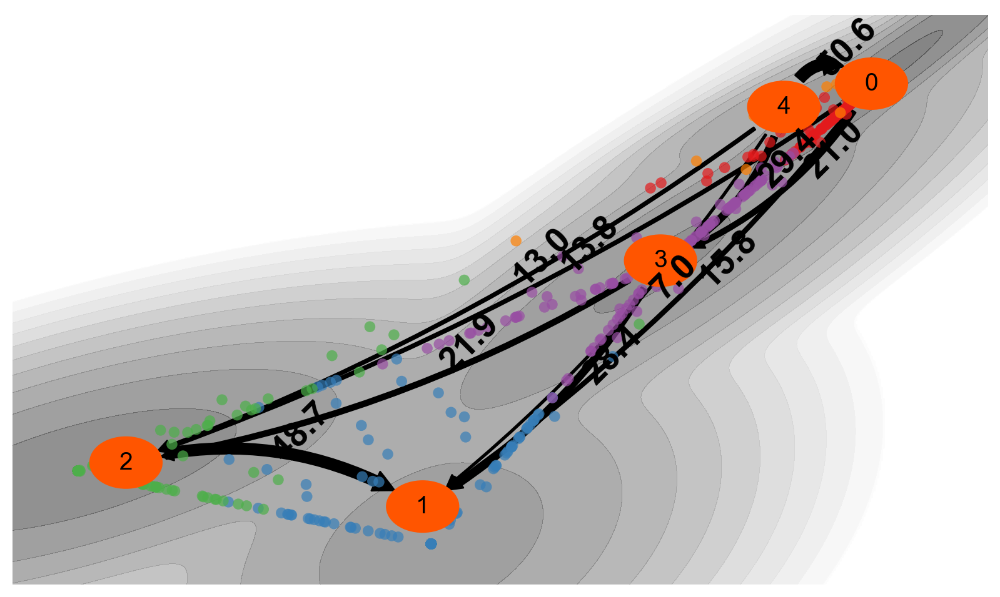

In [38]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 4,sf = 1, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_4_to_1_100.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_4_to_1_100.png")

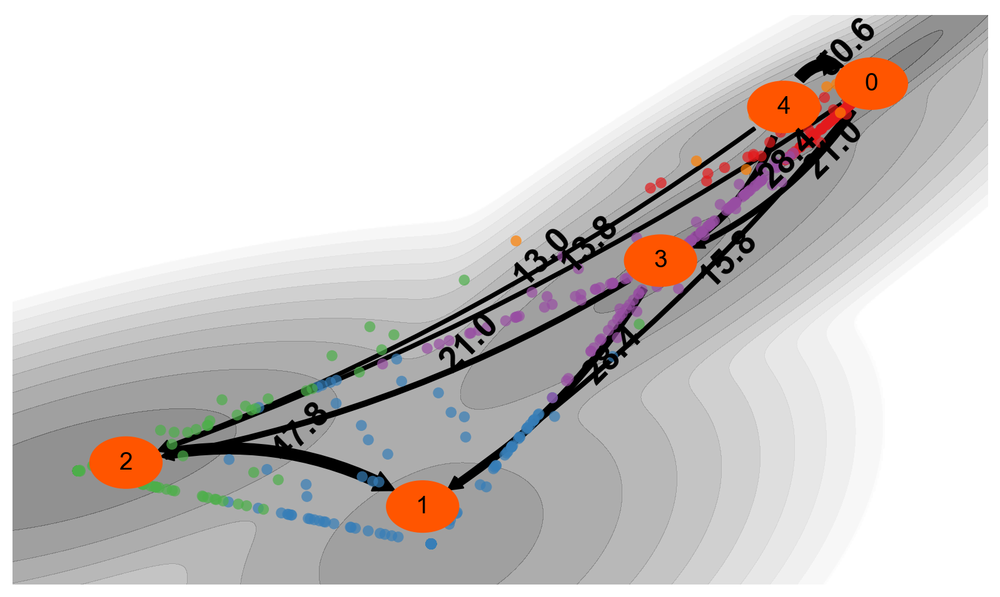

In [39]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 4,sf = 1, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_4_to_1_90.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_4_to_1_90.png")

MPPT from 0 to 1

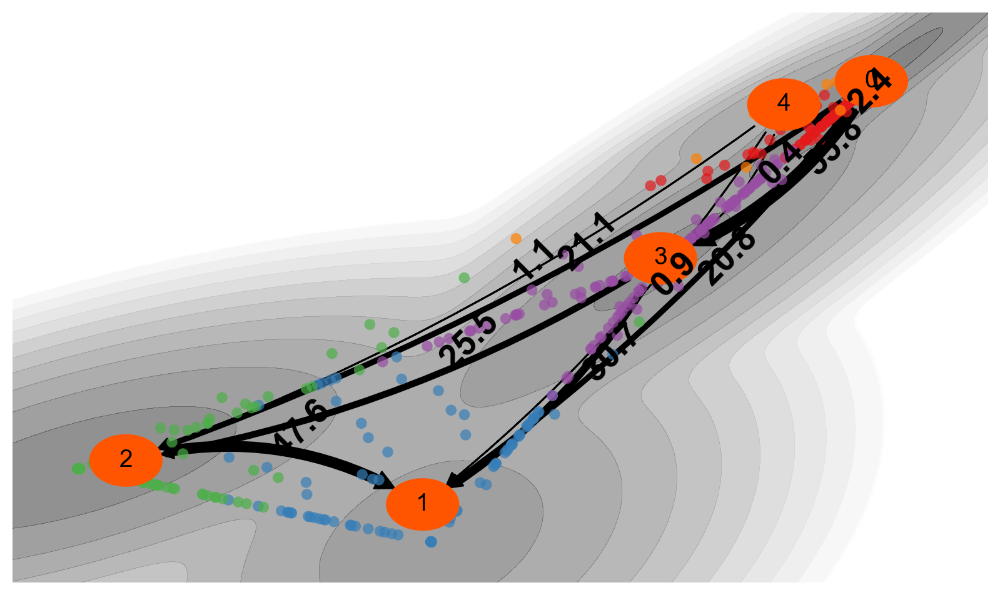

In [40]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 1, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_0_to_1_100.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_0_to_1_100.png")

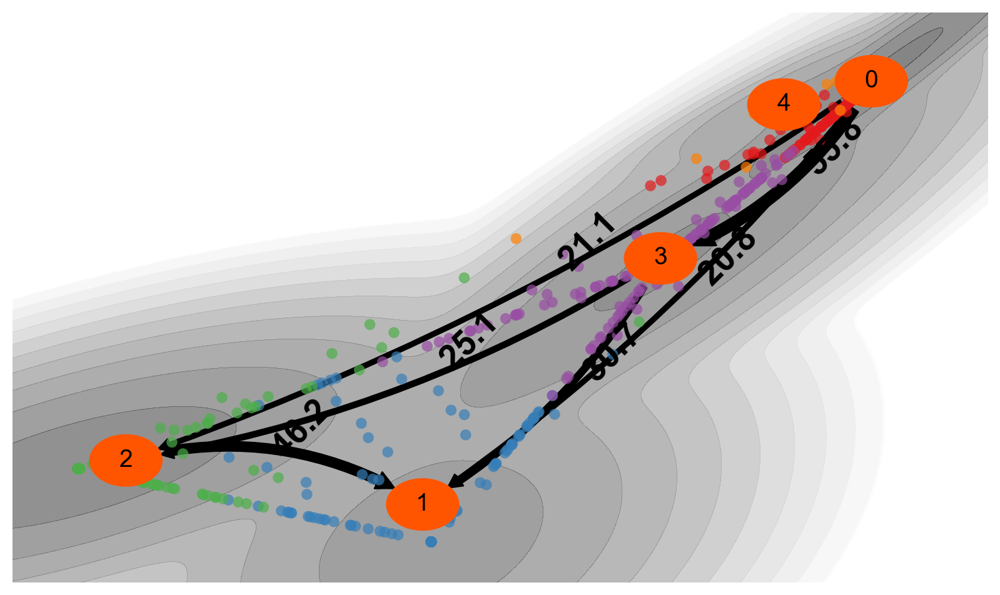

In [41]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 0,sf = 1, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_entry_mppt_0_to_1_90.pdf")
plt.savefig(plotdir+"nb067_entry_mppt_0_to_1_90.png")

In [42]:
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')

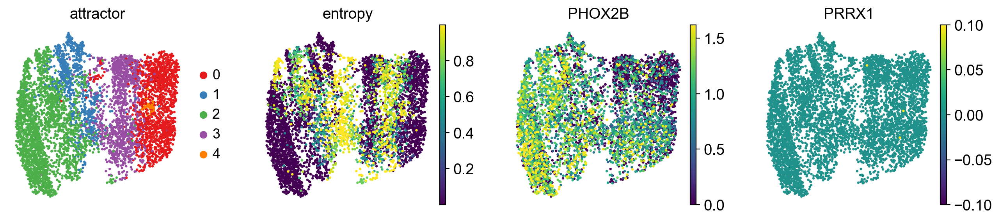

In [43]:
color_palette = sns.color_palette('Set1', 5)
sc.pl.umap(adata_mu, color = ['attractor', 'entropy', 'PHOX2B', 'PRRX1'], vmax = 'p95', palette = color_palette, show = False)
plt.savefig(plotdir+"nb067_entry_umap_attractor_entropy.pdf")
plt.savefig(plotdir+"nb067_entry_umap_attractor_entropy.png")

In [44]:
for keys in list(adata_mu.uns['da_out'].keys()):
    if type(adata_mu.uns['da_out'][keys]).__name__ == 'double':
        adata_mu.uns['da_out'][keys] = np.asarray(adata_mu.uns['da_out'][keys])    

for keys in list(adata_mu.uns['land'].keys()):
    if type(adata_mu.uns['land'][keys]).__name__ == 'double':
        adata_mu.uns['land'][keys] = np.asarray(adata_mu.uns['land'][keys])    

del adata_mu.uns['land']['model']

adata_mu.write(datadir+'nb067_entry_mutrans.h5ad')

In [45]:
del adata_mu.uns['da_out']
del adata_mu.uns['land']

In [46]:
adata_mu.write_h5ad(
    datadir+"nb067_entry_mutrans_mod.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

### Attractor annotation

In [28]:
plotdir = "../plots/nb067_entry/"

In [29]:
adata_mu = sc.read(datadir+'nb067_entry_mutrans.h5ad')
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')
color_palette = sns.color_palette('Set1', 5)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [30]:
conditions = [
    adata_mu.obs['attractor'] == 0,
    adata_mu.obs['attractor'] == 1,
    adata_mu.obs['attractor'] == 2,
    adata_mu.obs['attractor'] == 3,
    adata_mu.obs['attractor'] == 4
]

outputs = [
    'II', 'IV', 'I', 'III', 'V'
]

In [31]:
adata_mu.obs['energy_rank'] = np.select(conditions, outputs)

In [32]:
energy_pal = {
    'I' : color_palette[2],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[1],
    'V' : color_palette[4]
}

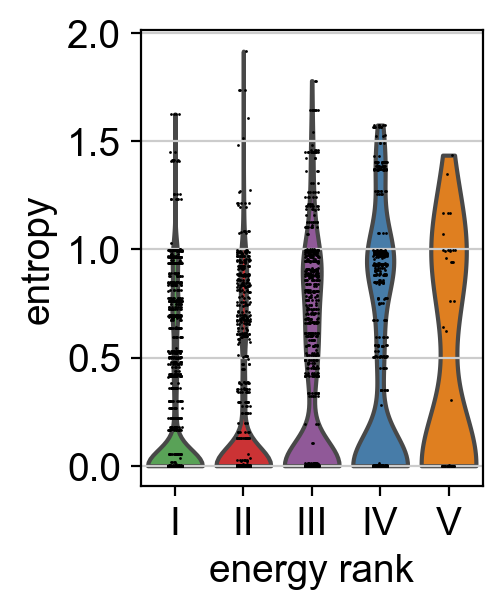

In [33]:
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
sc.pl.violin(adata_mu, keys = 'entropy', groupby='energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_entry_violin_attractor_entropy_ranked.pdf")
plt.savefig(plotdir+"nb067_entry_violin_attractor_entropy_ranked.png")

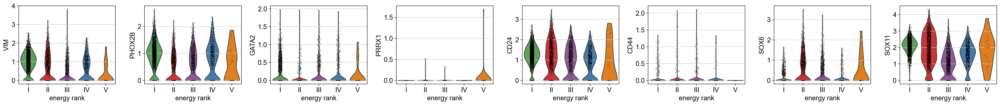

In [35]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['VIM','PHOX2B','GATA2','PRRX1','CD24','CD44','SOX6','SOX11'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_entry_violin_markers_ranked.pdf")
plt.savefig(plotdir+"nb067_entry_violin_markers_ranked.png")

In [36]:
adata_mu.write_h5ad(
    datadir+"nb067_entry_mutrans_ranked.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

#### Hybrid signature

In [ ]:
plotdir = "../plots/nb067_entry/"
adata_mu = sc.read(datadir+'nb067_entry_mutrans_ranked.h5ad')

In [37]:
hyb_sig = pd.read_csv(datadir+"method2_dge.csv")

In [38]:
hyb_list = hyb_sig['gene'].tolist()

In [39]:
sc.tl.score_genes(adata_mu, gene_list=hyb_list, ctrl_size=len(hyb_list), score_name="HYB.Sig")

In [ ]:
color_palette = sns.color_palette('Set1', 5)
energy_pal = {
    'I' : color_palette[2],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[1],
    'V' : color_palette[4]
}

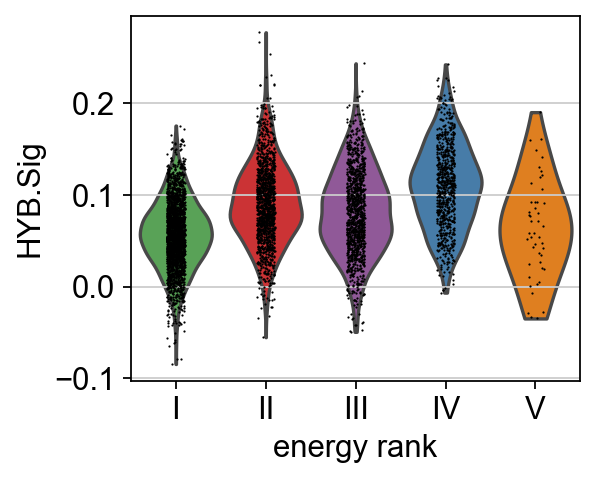

In [40]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = 'HYB.Sig', groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_entry_violin_hyb_ranked.pdf")
plt.savefig(plotdir+"nb067_entry_violin_hyb_ranked.png")

#### Dyer signature

In [72]:
plotdir = "../plots/nb067_entry/"
adata_mu = sc.read(datadir+'nb067_entry_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [73]:
color_palette = sns.color_palette('Set1', 5)
energy_pal = {
    'I' : color_palette[2],
    'II' : color_palette[0],
    'III' : color_palette[3],
    'IV' : color_palette[1],
    'V' : color_palette[4]
}

In [74]:
dyer_df = pd.read_csv(datadir+"Dyer_Sig.csv", header=None)
dyer_df.columns = ["Gene", "Signature"]

In [75]:
dyer_sig = {sig: dyer_df[dyer_df['Signature'] == sig]['Gene'].tolist() for sig in dyer_df['Signature'].unique()}
gene_lists = list(dyer_sig.values())

In [76]:
for gene_list, score_name in zip(gene_lists, ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer']):
    sc.tl.score_genes(adata_mu, gene_list=gene_list, score_name=score_name, random_state=12345)

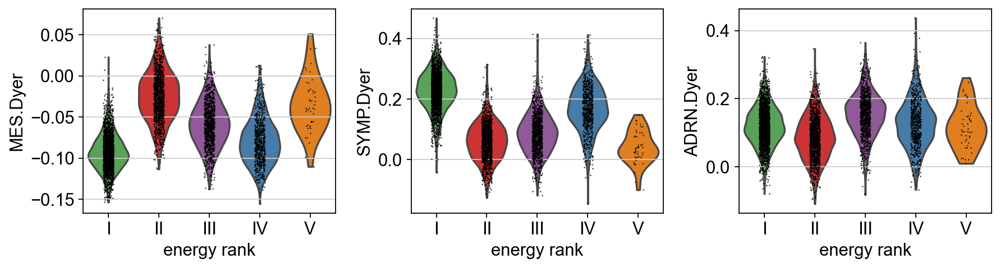

In [77]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_entry_violin_dyer_ranked.pdf")
plt.savefig(plotdir+"nb067_entry_violin_dyer_ranked.png")

## NB067 exit

In [41]:
import pandas as pd
import numpy as np
import scanpy as sc
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
import matplotlib.pyplot as plt
import pyMuTrans as pm
import hdf5plugin
import gc
import seaborn as sns

datadir = "data/"

In [2]:
adata = sc.read(datadir+'nb067_exit_seurat.h5ad')
adata

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 5649 × 22192
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Barcode', 'CellID', 'sizeFactor', 'description', 'CMO', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'sum', 'detected', 'subsets_mt_sum', 'subsets_mt_detected', 'subsets_mt_percent', 'subsets_linc_sum', 'subsets_linc_detected', 'subsets_linc_percent', 'subsets_ribo_sum', 'subsets_ribo_detected', 'subsets_ribo_percent', 'total', 'Seurat.Phase', 'Seurat.S', 'Seurat.G2M', 'Seurat.Cycle.Score', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.3', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'

In [3]:
adata.layers["raw_counts"] = adata.raw.X
adata.layers["seurat_lognorm"] = adata.X
adata.X = adata.raw.X

In [4]:
adata.obs = adata.obs[['Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig']]
adata.obsm = []
adata

AnnData object with n_obs × n_vars = 5649 × 22192
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig'
    var: 'features'
    layers: 'raw_counts', 'seurat_lognorm'

In [5]:
# Check adata has raw counts matrix
df = pd.DataFrame.sparse.from_spmatrix(adata.X)
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,22182,22183,22184,22185,22186,22187,22188,22189,22190,22191
0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,...,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,2.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,6.0,...,5.0,0.0,1.0,0.0,0.0,7.0,0.0,0.0,0.0,3.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,...,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0
6,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,19.0,...,5.0,0.0,3.0,0.0,0.0,2.0,0.0,0.0,0.0,2.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,2.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0


### Pre-processing

QC

In [6]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars = ['mt'], percent_top = None, log1p = False, inplace = True)

Normalisation

In [7]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)

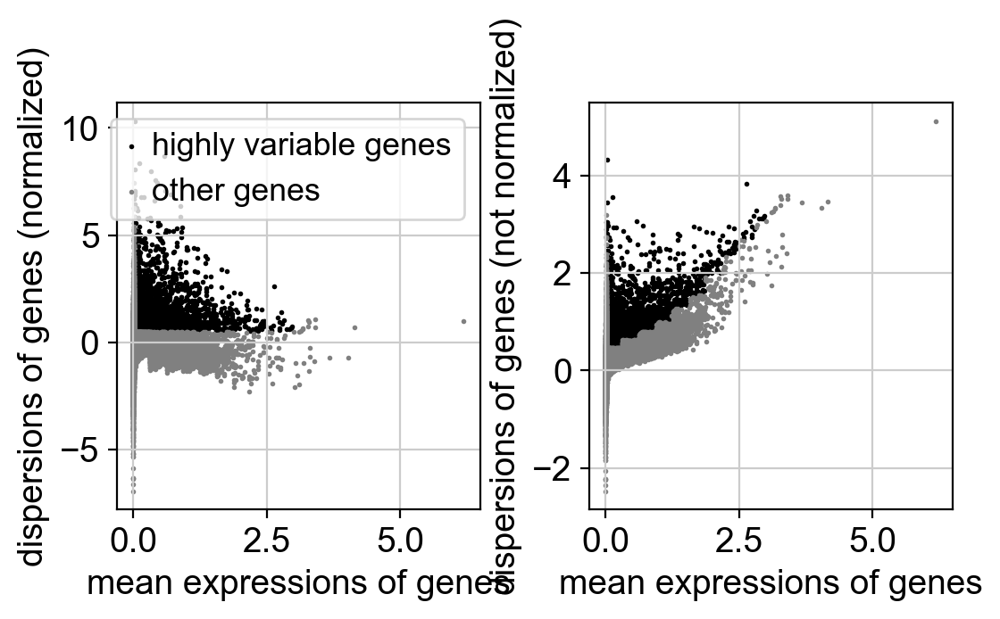

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
# Set .raw attribute of AnnData object to the normalised and logarithmized raw gene expression
adata.raw = adata
# Filter for highly variable genes
adata = adata[:, adata.var.highly_variable]

In [10]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\_core\anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df

In [11]:
sc.pp.scale(adata, max_value = 10) # Clips values exceeding sd = 10

Reduced dims

In [12]:
sc.tl.pca(adata, svd_solver = 'arpack')

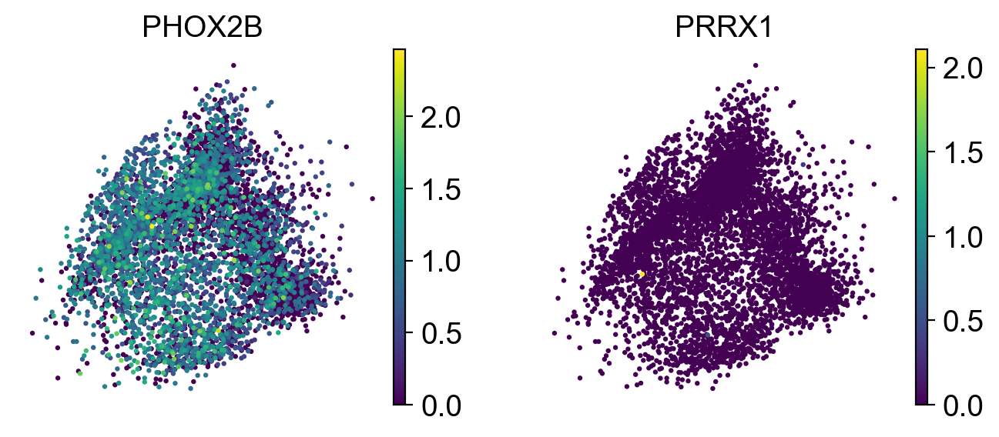

In [13]:
sc.pl.pca(adata, color = ['PHOX2B','PRRX1'])

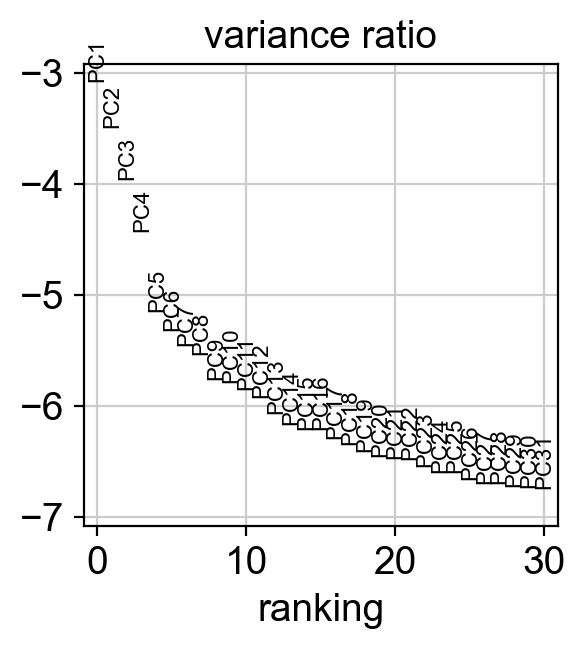

In [14]:
sc.pl.pca_variance_ratio(adata, log = True)

In [15]:
sc.pp.neighbors(adata, n_neighbors = 10, n_pcs = 40)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\umap\distances.py:1086: NumbaD

In [16]:
sc.tl.umap(adata)

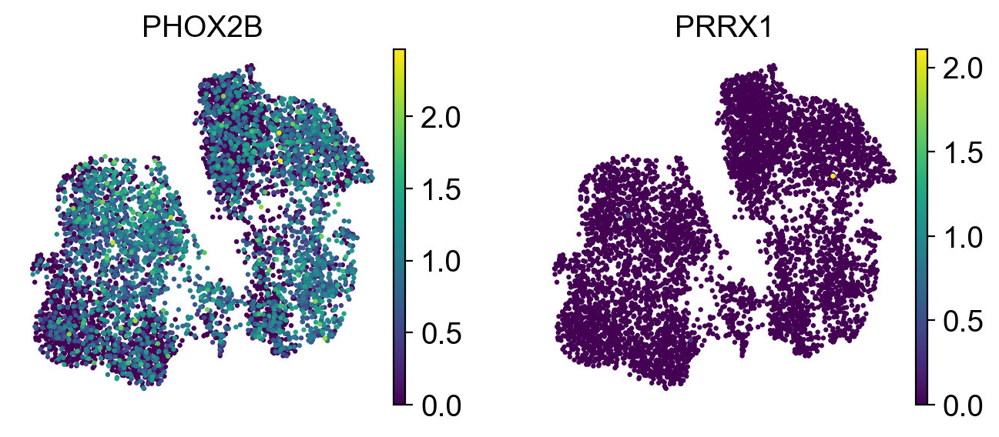

In [17]:
sc.pl.umap(adata, color = ['PHOX2B', 'PRRX1'])

Clustering

In [18]:
sc.tl.leiden(adata, resolution = 0.2)

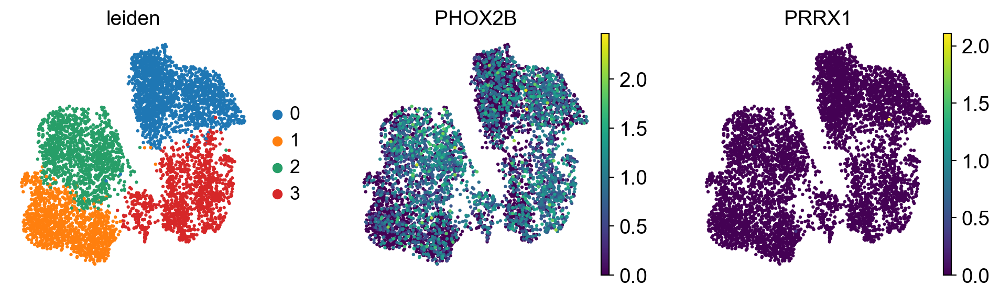

In [19]:
sc.pl.umap(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

In [20]:
adata.write_h5ad(
    datadir+"nb067_exit_scanpy.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

Marker genes

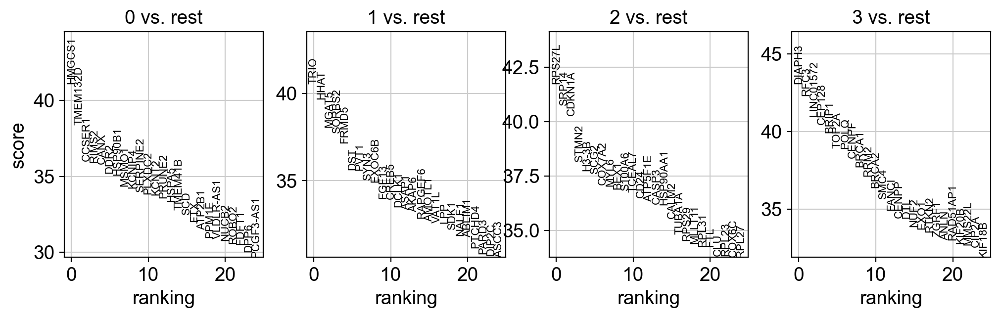

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method = 'wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes = 25, sharey = False)

PAGA analysis

In [22]:
adata = sc.read(datadir+"nb067_exit_scanpy.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


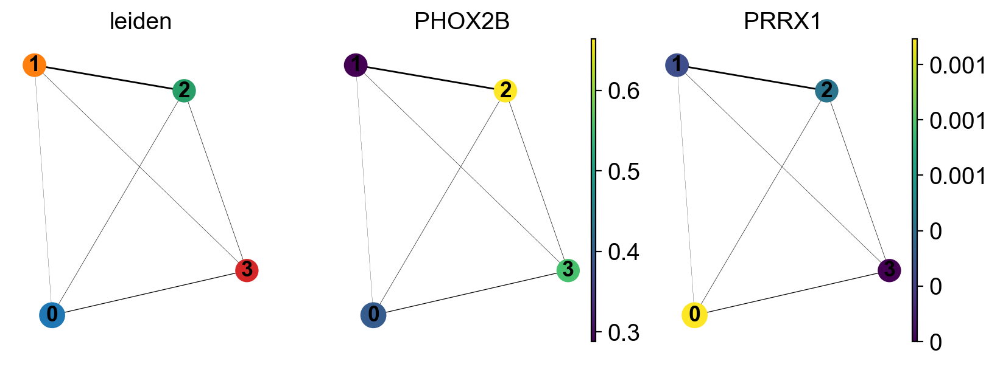

In [23]:
sc.tl.paga(adata, groups = 'leiden')
sc.pl.paga(adata, color = ['leiden', 'PHOX2B', 'PRRX1'])

### Mutrans analysis

In [24]:
sc.tl.tsne(adata, n_pcs = 30)

In [25]:
sc.pp.neighbors(adata, metric = 'cosine', n_neighbors = 60, use_rep = 'X')

In [26]:
adata.write_h5ad(
    datadir+"nb067_exit_scanpy_nn.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

#### Start run from here

In [27]:
plotdir = "../plots/nb067_exit/"

In [28]:
adata = sc.read(datadir+"nb067_exit_scanpy_nn.h5ad")

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [29]:
gc.collect()

18998

In [30]:
par = {"choice_distance":"cosine","K_cluster":4.0,"trials":50,"weight_scale":True,"initial":"pca","reduce_large_scale":True,"reduce_num_meta_cell":1000.0,"fig_name": plotdir+"dynam_out"} 
adata_mu = pm.dynamical_analysis(adata, par)
out = adata_mu.uns['da_out']
ind = np.argsort(np.asarray(out['perm_class']).ravel().astype(int)-1)
labels_in_meta = np.asarray(out['reduce_class']).ravel().astype(int)-1
attractor_meta = np.asarray(out['class_order']).ravel()[ind]-1
adata_mu.obs['attractor'] = [ int(attractor_meta[labels_in_meta[i]]) for i in range(len(labels_in_meta))]
entropy_meta = np.asarray(out['H']).ravel()[ind]
adata_mu.obs['entropy'] = [entropy_meta[labels_in_meta[i]] for i in range(len(labels_in_meta))]

In [20]:
adata_mu

AnnData object with n_obs × n_vars = 5649 × 3079
    obs: 'Sample', 'Barcode', 'description', 'Model', 'Condition', 'Rec', 'Replicate', 'batch', 'Sample_Type', 'seurat_clusters', 'MES.Sig', 'ADRN.Sig', 'AMT.Sig', 'AMT.score', 'AMT.state', 'Cluster_Name', 'Coexprs.Sig', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'attractor', 'entropy'
    var: 'features', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'attractor_colors', 'da_out', 'hvg', 'land', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'seurat_lognorm'
    obsp: 'connectivities', 'distances'

In [21]:
np.asarray(adata_mu.uns['da_out']['mu_hat'])

array([[0.2748843 ],
       [0.53560263],
       [0.1839097 ],
       [0.00560336]])

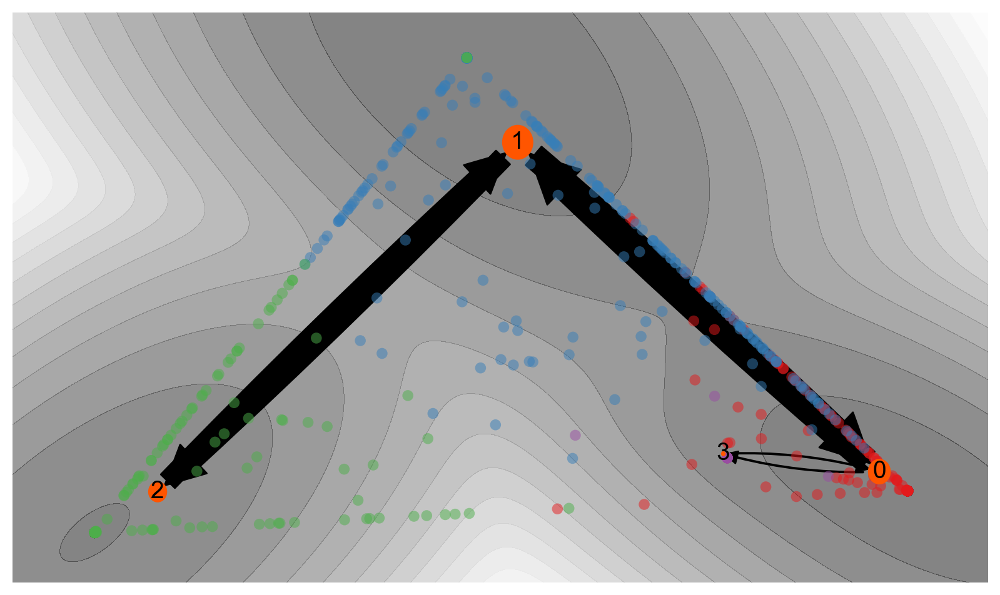

In [33]:
fig = plt.figure(figsize = (10, 6))
pm.infer_lineage(adata_mu, method = "MPFT", size_point = 40, alpha_point = 0.5, size_text = 15)
plt.savefig(plotdir+"nb067_exit_mpft.pdf")
plt.savefig(plotdir+"nb067_exit_mpft.png")

MPPT from 2 to 3

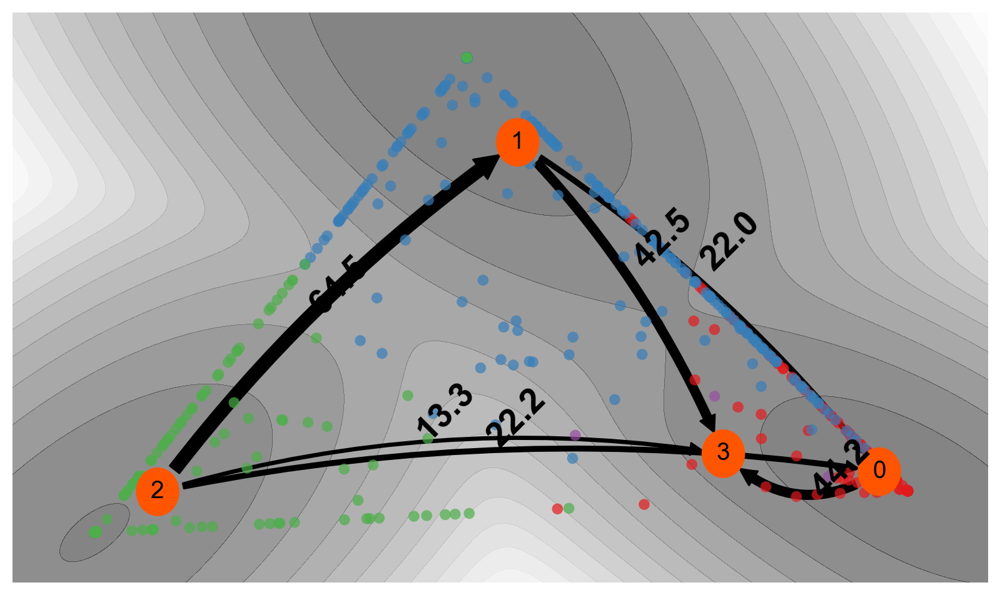

In [36]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 2,sf = 3, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_exit_mppt_2_to_3_100.pdf")
plt.savefig(plotdir+"nb067_exit_mppt_2_to_3_100.png")

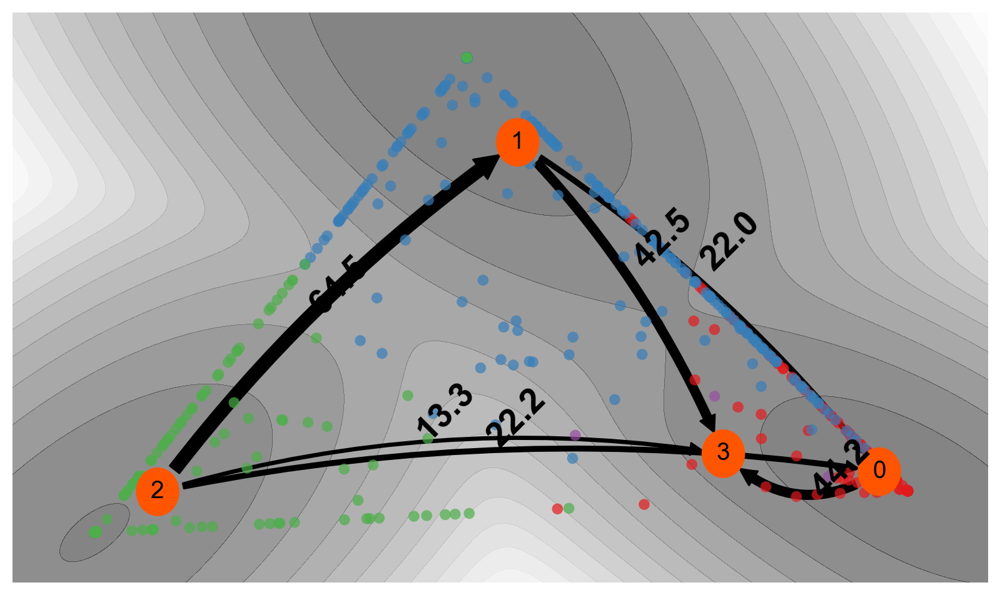

In [37]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 2,sf = 3, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_exit_mppt_2_to_3_90.pdf")
plt.savefig(plotdir+"nb067_exit_mppt_2_to_3_90.png")

MPPT from 3 to 2

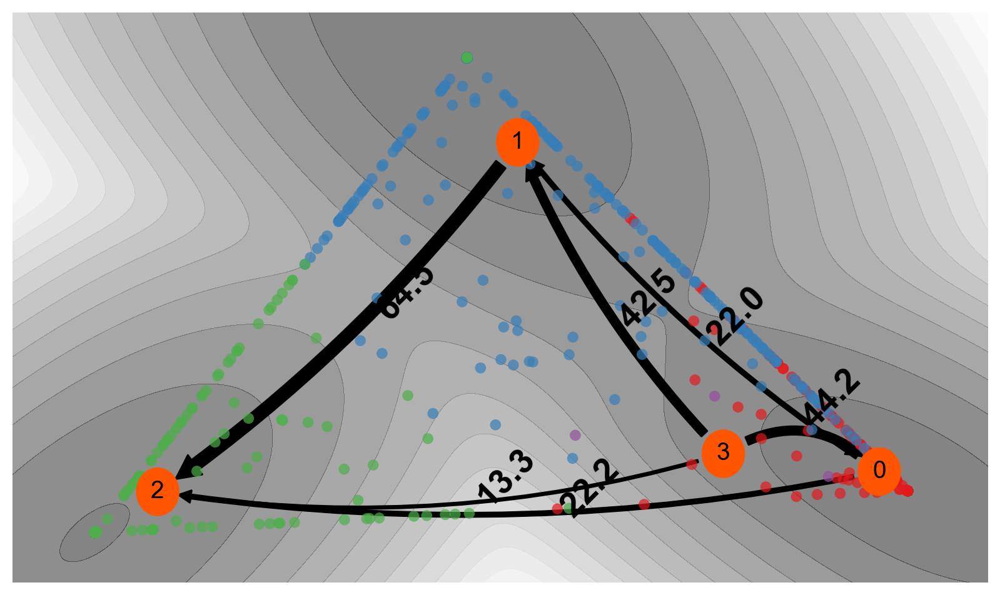

In [34]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 3,sf = 2, flux_fraction = 1, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_exit_mppt_3_to_2_100.pdf")
plt.savefig(plotdir+"nb067_exit_mppt_3_to_2_100.png")

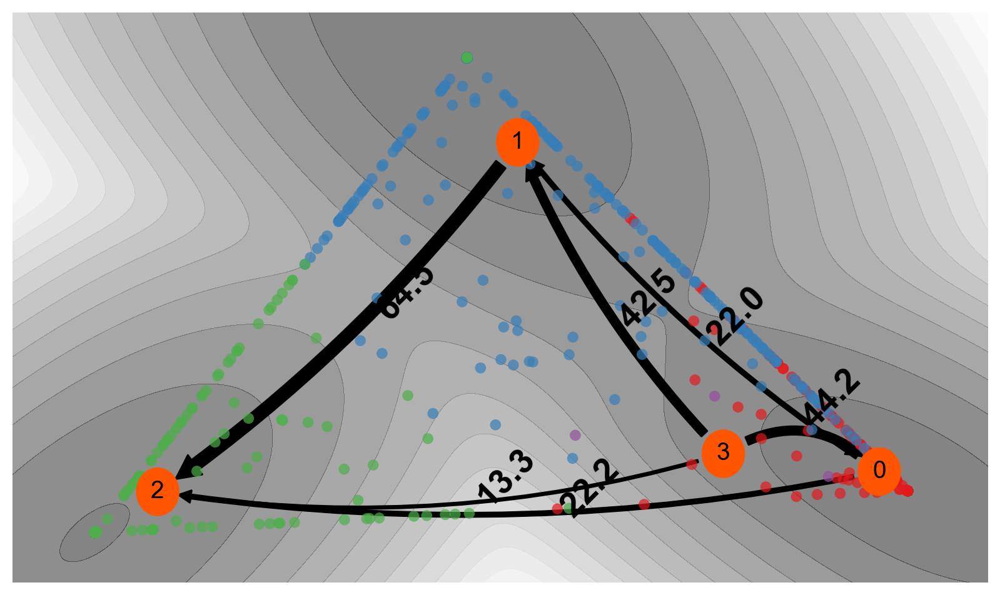

In [35]:
fig = plt.figure(figsize = (10,6))
pm.infer_lineage(adata_mu,si = 3,sf = 2, flux_fraction = 0.9, method = "MPPT", size_state = 0.2, size_point = 40, size_text = 20, alpha_point = 0.7)
plt.savefig(plotdir+"nb067_exit_mppt_3_to_2_90.pdf")
plt.savefig(plotdir+"nb067_exit_mppt_3_to_2_90.png")

In [38]:
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')

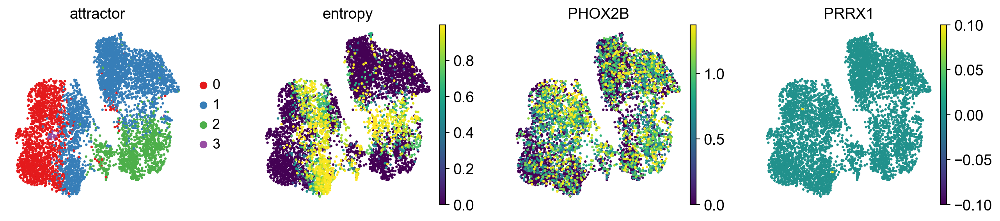

In [40]:
color_palette = sns.color_palette('Set1', 4)
sc.pl.umap(adata_mu, color = ['attractor', 'entropy', 'PHOX2B', 'PRRX1'], vmax = 'p95', palette = color_palette, show = False)
plt.savefig(plotdir+"nb067_exit_umap_attractor_entropy.pdf")
plt.savefig(plotdir+"nb067_exit_umap_attractor_entropy.png")

In [41]:
for keys in list(adata_mu.uns['da_out'].keys()):
    if type(adata_mu.uns['da_out'][keys]).__name__ == 'double':
        adata_mu.uns['da_out'][keys] = np.asarray(adata_mu.uns['da_out'][keys])    

for keys in list(adata_mu.uns['land'].keys()):
    if type(adata_mu.uns['land'][keys]).__name__ == 'double':
        adata_mu.uns['land'][keys] = np.asarray(adata_mu.uns['land'][keys])    

del adata_mu.uns['land']['model']

adata_mu.write(datadir+'nb067_exit_mutrans.h5ad')

In [42]:
del adata_mu.uns['da_out']
del adata_mu.uns['land']

In [43]:
adata_mu.write_h5ad(
    datadir+"nb067_exit_mutrans_mod.h5ad",
    compression = hdf5plugin.FILTERS["zstd"]
)

### Attractor annotation

In [42]:
plotdir = "../plots/nb067_exit/"

In [43]:
adata_mu = sc.read(datadir+'nb067_exit_mutrans.h5ad')
adata_mu.obs['attractor'] = adata_mu.obs.attractor.astype('category')
color_palette = sns.color_palette('Set1', 4)

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [44]:
conditions = [
    adata_mu.obs['attractor'] == 0,
    adata_mu.obs['attractor'] == 1,
    adata_mu.obs['attractor'] == 2,
    adata_mu.obs['attractor'] == 3
]

outputs = [
    'II', 'I', 'III', 'IV'
]

In [45]:
adata_mu.obs['energy_rank'] = np.select(conditions, outputs)

In [46]:
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[2],
    'IV' : color_palette[3]
}

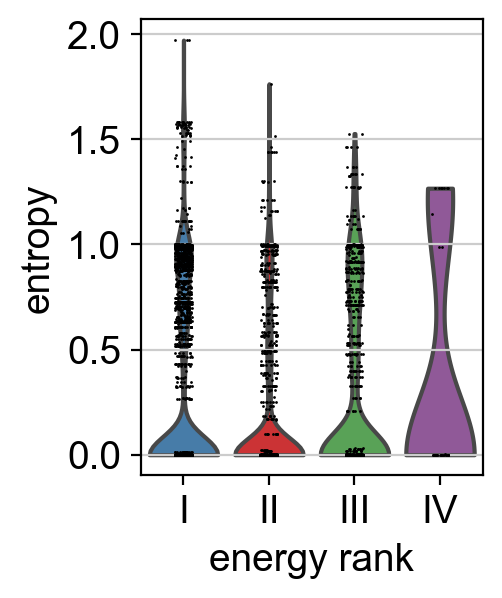

In [47]:
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(3, 3), facecolor='white')
sc.pl.violin(adata_mu, keys = 'entropy', groupby='energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_exit_violin_attractor_entropy_ranked.pdf")
plt.savefig(plotdir+"nb067_exit_violin_attractor_entropy_ranked.png")

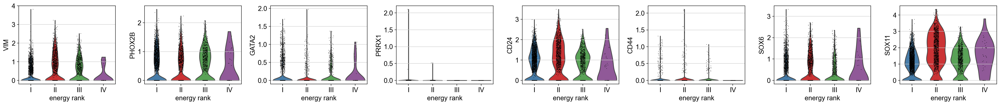

In [48]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['VIM','PHOX2B','GATA2','PRRX1','CD24','CD44','SOX6','SOX11'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_exit_violin_markers_ranked.pdf")
plt.savefig(plotdir+"nb067_exit_violin_markers_ranked.png")

In [49]:
adata_mu.write_h5ad(
    datadir+"nb067_exit_mutrans_ranked.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

#### Hybrid signature

In [51]:
plotdir = "../plots/nb067_exit/"
adata_mu = sc.read(datadir+'nb067_exit_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [52]:
hyb_sig = pd.read_csv(datadir+"method2_dge.csv")

In [53]:
hyb_list = hyb_sig['gene'].tolist()

In [54]:
sc.tl.score_genes(adata_mu, gene_list=hyb_list, ctrl_size=len(hyb_list), score_name="HYB.Sig")

In [55]:
color_palette = sns.color_palette('Set1', 4)
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[2],
    'IV' : color_palette[3]
}

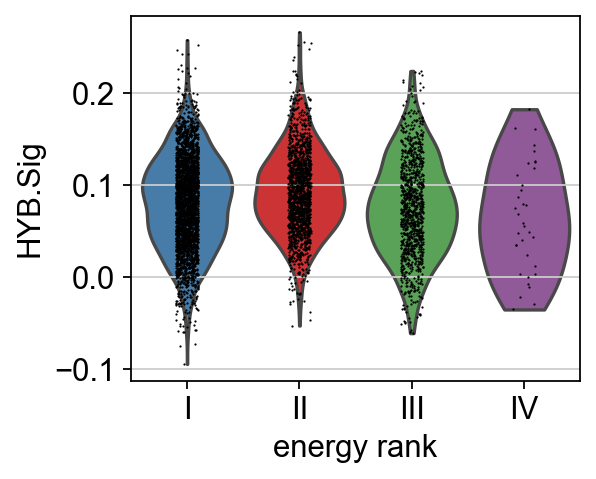

In [56]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = 'HYB.Sig', groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_exit_violin_hyb_ranked.pdf")
plt.savefig(plotdir+"nb067_exit_violin_hyb_ranked.png")

#### Dyer signature

In [78]:
plotdir = "../plots/nb067_exit/"
adata_mu = sc.read(datadir+'nb067_exit_mutrans_ranked.h5ad')

c:\Users\echen\Anaconda3\envs\mutrans\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [79]:
color_palette = sns.color_palette('Set1', 4)
energy_pal = {
    'I' : color_palette[1],
    'II' : color_palette[0],
    'III' : color_palette[2],
    'IV' : color_palette[3]
}

In [80]:
dyer_df = pd.read_csv(datadir+"Dyer_Sig.csv", header=None)
dyer_df.columns = ["Gene", "Signature"]

In [81]:
dyer_sig = {sig: dyer_df[dyer_df['Signature'] == sig]['Gene'].tolist() for sig in dyer_df['Signature'].unique()}
gene_lists = list(dyer_sig.values())

In [82]:
for gene_list, score_name in zip(gene_lists, ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer']):
    sc.tl.score_genes(adata_mu, gene_list=gene_list, score_name=score_name, random_state=12345)

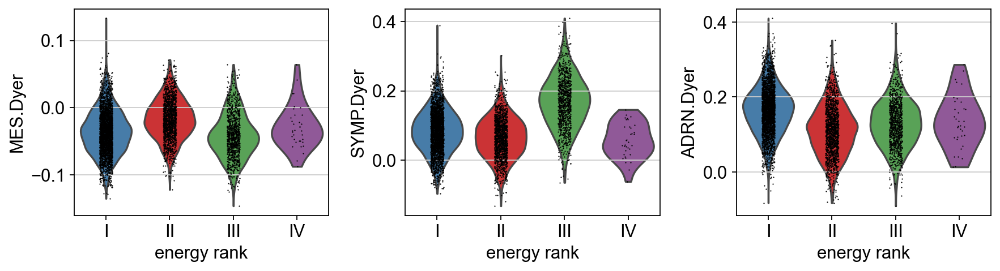

In [83]:
sc.settings.set_figure_params(frameon=False,figsize=(4, 3))
sc.pl.violin(adata_mu, keys = ['MES.Dyer', 'SYMP.Dyer', 'ADRN.Dyer'], groupby = 'energy_rank', show=False, palette = energy_pal)
plt.savefig(plotdir+"nb067_exit_violin_dyer_ranked.pdf")
plt.savefig(plotdir+"nb067_exit_violin_dyer_ranked.png")